In [1]:
%load_ext autoreload
%autoreload 2
from CO2_identify import *
from labeling import dataload,show3D
from mynetwork import CO2mask
from torch.utils.data import DataLoader
from scipy.ndimage import gaussian_filter
from torchvision.transforms.functional import resize

import torchvision
import torch
import torch.optim as optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
import json
from torchstat import stat

In [2]:
fn = '../define_path.txt'
with open(fn) as f:
    lines = f.readlines()
for idx, line in enumerate(lines):
    if idx == 1:
        dir_co2 = line.split('=')[1][:-1]
    if idx == 3:
        dir_grid = line.split('=')[1][:-1]
    if idx == 7:
        root = line.split('=')[1][:-1]

# NN for CO2 mask identification

## Load datasets

In [3]:
# dataset information file names
pmf = 'pm_info.json'
pdf = 'patch_info'
pdfap = '.csv'

In [4]:
# load training dataset
train = dataset_patch(root,pmf,f'{pdf}_train{pdfap}',sliceitp=True)
Ntrain = len(train)
sliceitp = train.sliceitp
print(f'Training dataset size: {Ntrain}')

Training dataset size: 1500


In [5]:
# load validating dataset
valid = dataset_patch(root,pmf,f'{pdf}_valid{pdfap}',sliceitp=True)
Nvalid = len(valid)
print(f'Validating dataset size: {Nvalid}')

Validating dataset size: 132


In [6]:
# network path
#path_net = f'../resources/NNpred3D/train_sparselabel/co2_identify_sps.pt'
#path_bestnet = f'../resources/NNpred3D/train_sparselabel/co2_identify_best_sps.pt'

In [7]:
# network path
path_net = f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_sparselabel/co2_identify_sps.pt'
path_bestnet = f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_sparselabel/co2_identify_best_sps.pt'

## Display sampled patches in training and validating dataset

In [8]:
# define the sampled patches in training dataset for display
ndis_tr = 5
#train_id_list = np.random.choice(len(train),size=ndis_tr,replace=False)
train_id_list = np.linspace(0,Ntrain,ndis_tr+2,dtype=np.int16)[1:-1]
pst = patch_show(train,train_id_list)
print(f'train_id_list: {train_id_list}')
# define the sampled patches in valid dataset for display
ndis_va = 3
#valid_id_list = np.random.choice(len(valid),size=ndis_va,replace=False)
valid_id_list = np.linspace(0,Nvalid,ndis_va+2,dtype=np.int16)[1:-1]
psv = patch_show(valid,valid_id_list)
print(f'valid_id_list: {valid_id_list}')
# data patch resize shape
rs = valid.nsz
# sampling rate of epoch for display
epoch_itv = 20
# sampling rate of batch number for display
batch_itv = 10

train_id_list: [ 250  500  750 1000 1250]
valid_id_list: [33 66 99]


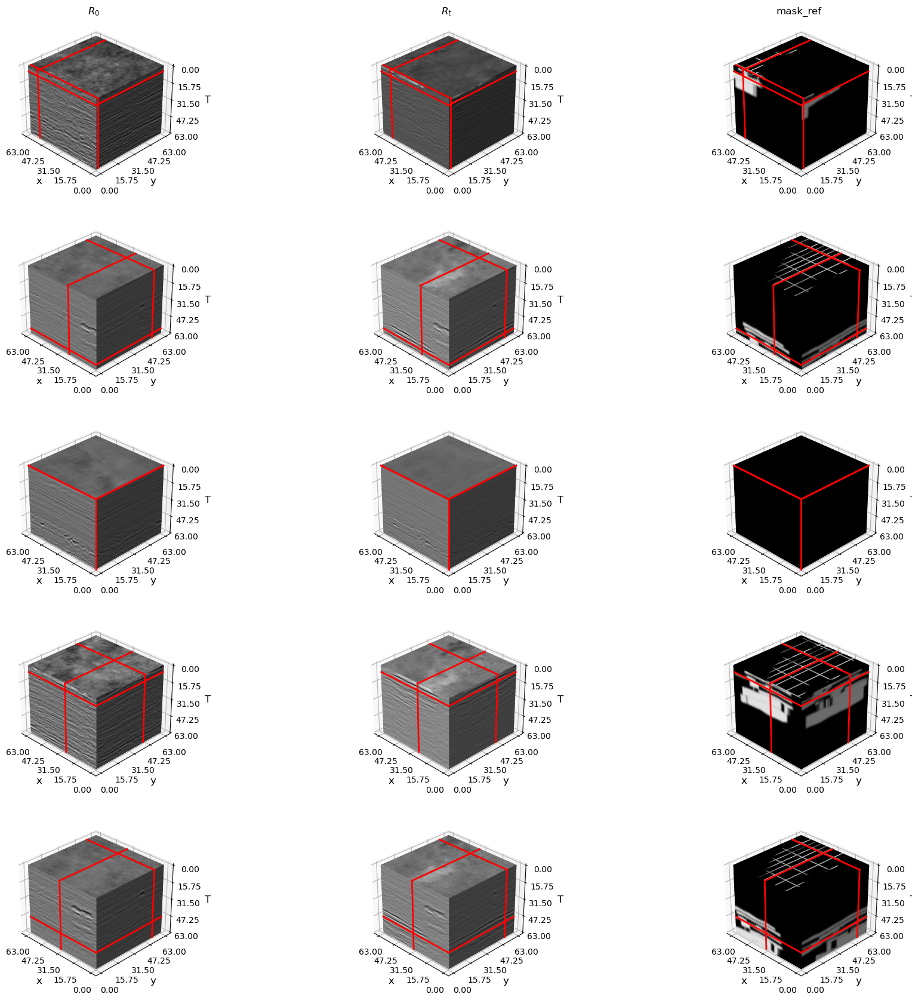

In [9]:
pst.view3d(rcstride=(1,1))

In [10]:
#psv.view3d(rcstride=(1,1))

## Training and validating

### Define training parameters

In [11]:
params = OrderedDict(
    lr = [.0002]
    ,batch_size = [30]
    ,shuffle = [True]
    ,epoch_num = [200]
    ,adadelta_num = [0]
)
cuda_gpu = True
gpus = [0]

In [12]:
# initilize run
M = RunManager(cuda_gpu)

In [13]:
# define sampler for loading valid_set
#valid_sampler = SubsetSampler(valid_id_list)
cpu_device = torch.device('cpu')

In [14]:
# define the resize class for combining the predicted validating patches
vrs3 = resize3d(Nvalid,D=valid.osz[0],H=valid.osz[1],W=valid.osz[2])

### Start training and validation

In [15]:
st = time.time()

Epoch No.: 0
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 0: 0.09848946139216423
Training patch samples display at epoch No. 0


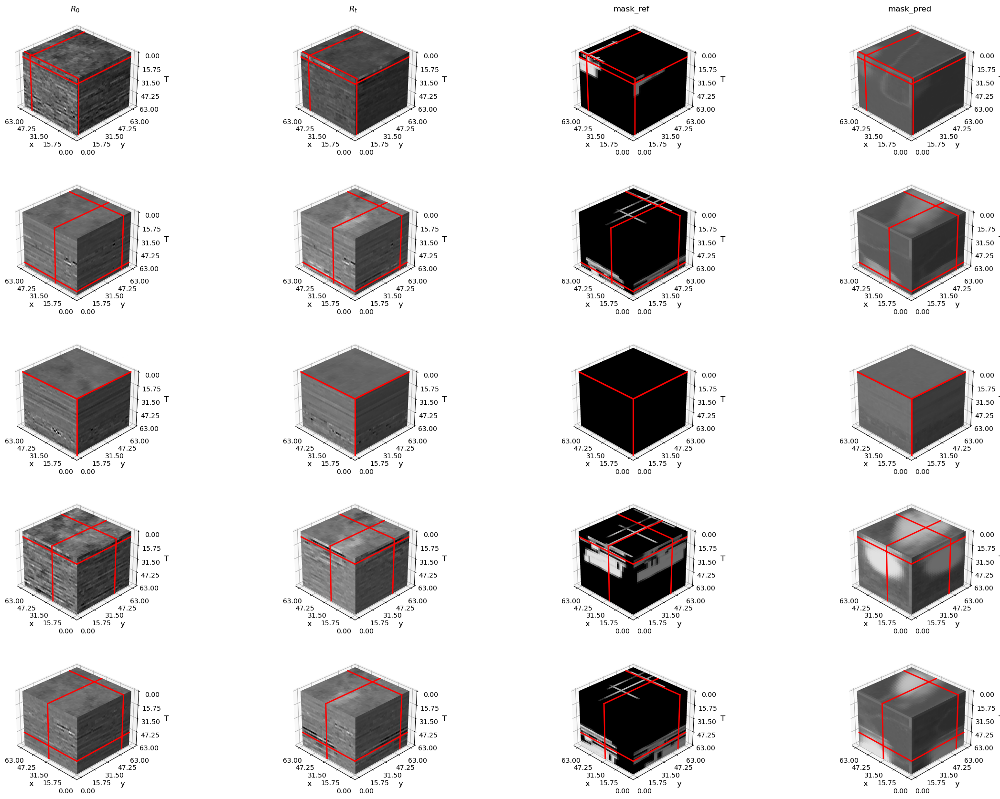

Start validating for epoch No. 0
Mean validating loss for epoch No. 0: 0.09426459195938977
Validating patch samples display at epoch No. 0


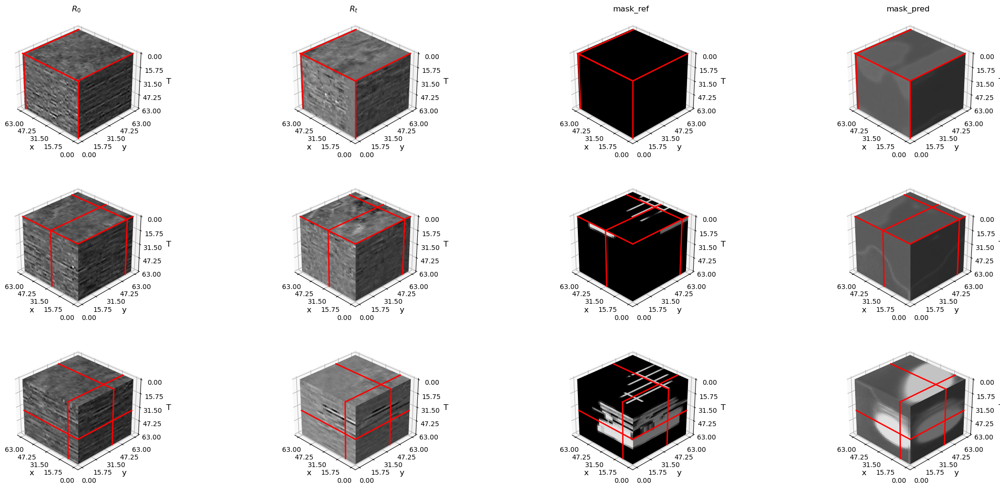

Epoch No.: 1
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 1: 0.02736508149653673
Start validating for epoch No. 1
Mean validating loss for epoch No. 1: 0.014910413629629395
Epoch No.: 2
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 2: 0.012715108776465058
Start validating for epoch No. 2
Mean validating loss for epoch No. 2: 0.013380772074345838
Epoch No.: 3
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 3: 0.012228218130767346
Start validating for epoch No. 3
Mean validating loss for epoch No. 3: 0.011814311062070456
Epoch No.: 4
Batch No. 

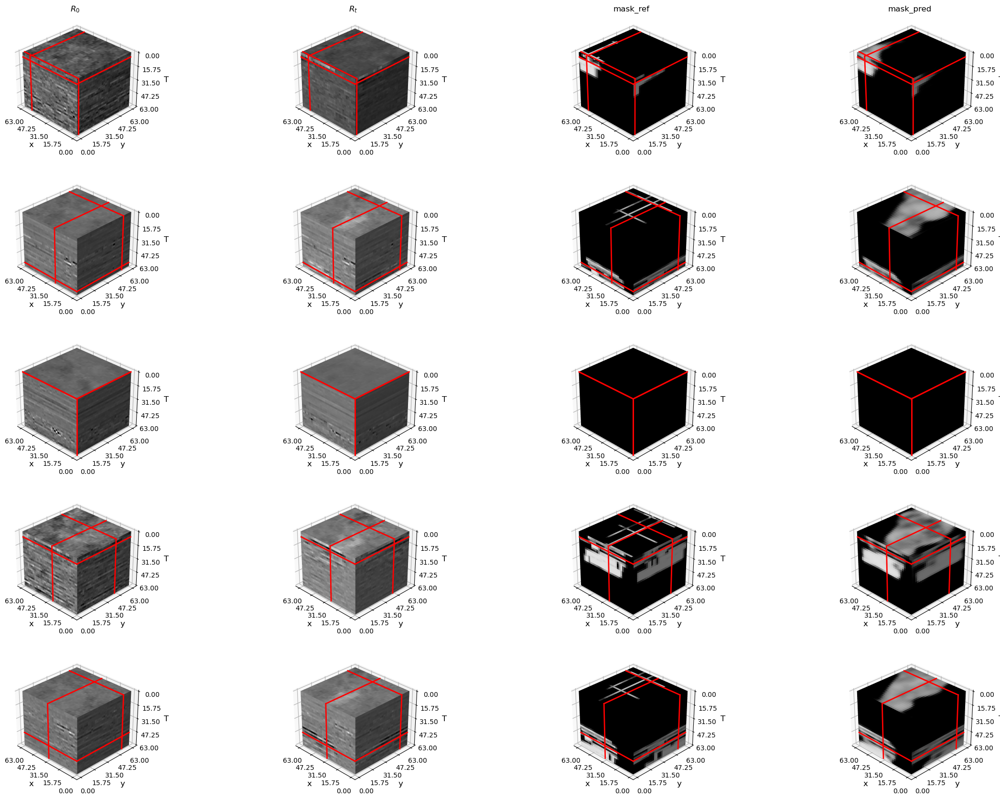

Start validating for epoch No. 20
Mean validating loss for epoch No. 20: 0.006411280525340276
Validating patch samples display at epoch No. 20


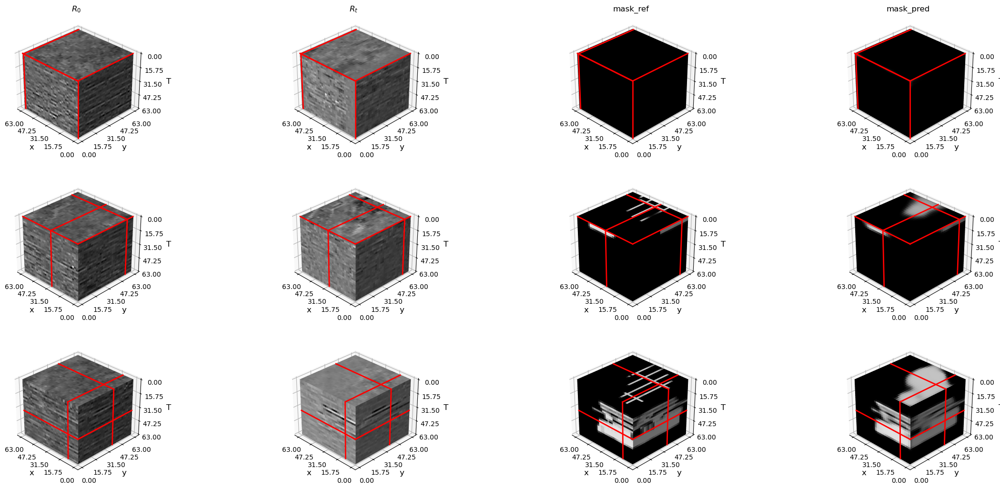

Epoch No.: 21
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 21: 0.006029437920078635
Start validating for epoch No. 21
Mean validating loss for epoch No. 21: 0.006518323101441969
Epoch No.: 22
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 22: 0.006030552606098354
Start validating for epoch No. 22
Mean validating loss for epoch No. 22: 0.006334161745722999
Epoch No.: 23
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 23: 0.005937535730190575
Start validating for epoch No. 23
Mean validating loss for epoch No. 23: 0.006310996408997612
Epoch No.:

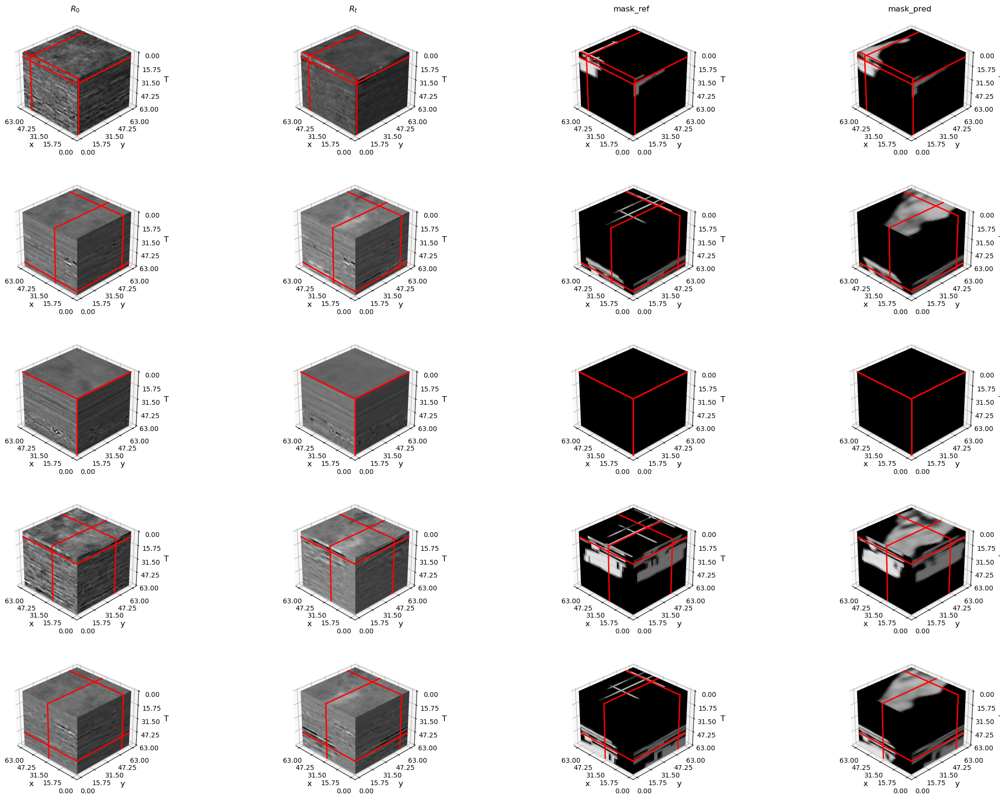

Start validating for epoch No. 40
Mean validating loss for epoch No. 40: 0.005627027236517857
Validating patch samples display at epoch No. 40


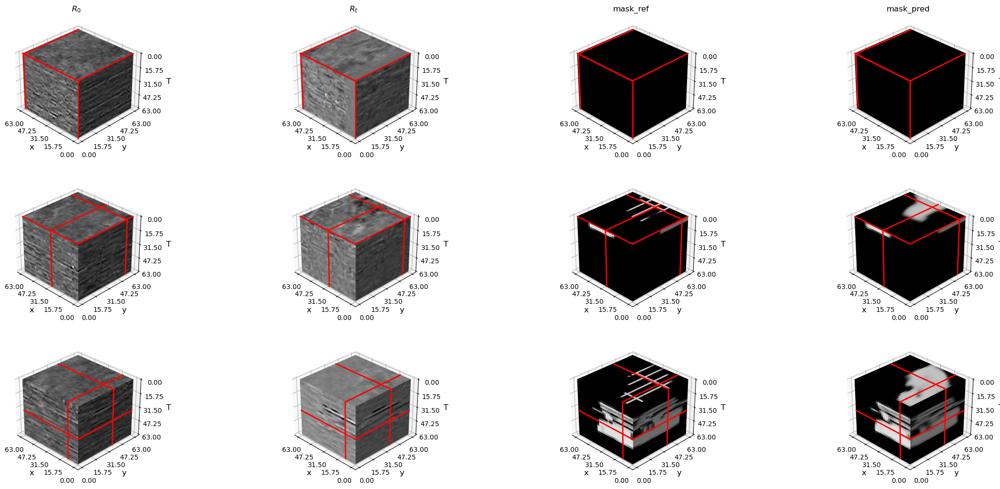

Epoch No.: 41
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 41: 0.005385069968178868
Start validating for epoch No. 41
Mean validating loss for epoch No. 41: 0.005748815633441237
Epoch No.: 42
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 42: 0.005331672211177647
Start validating for epoch No. 42
Mean validating loss for epoch No. 42: 0.005621716665866023
Epoch No.: 43
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 43: 0.005259535629302263
Start validating for epoch No. 43
Mean validating loss for epoch No. 43: 0.005614352592436428
Epoch No.:

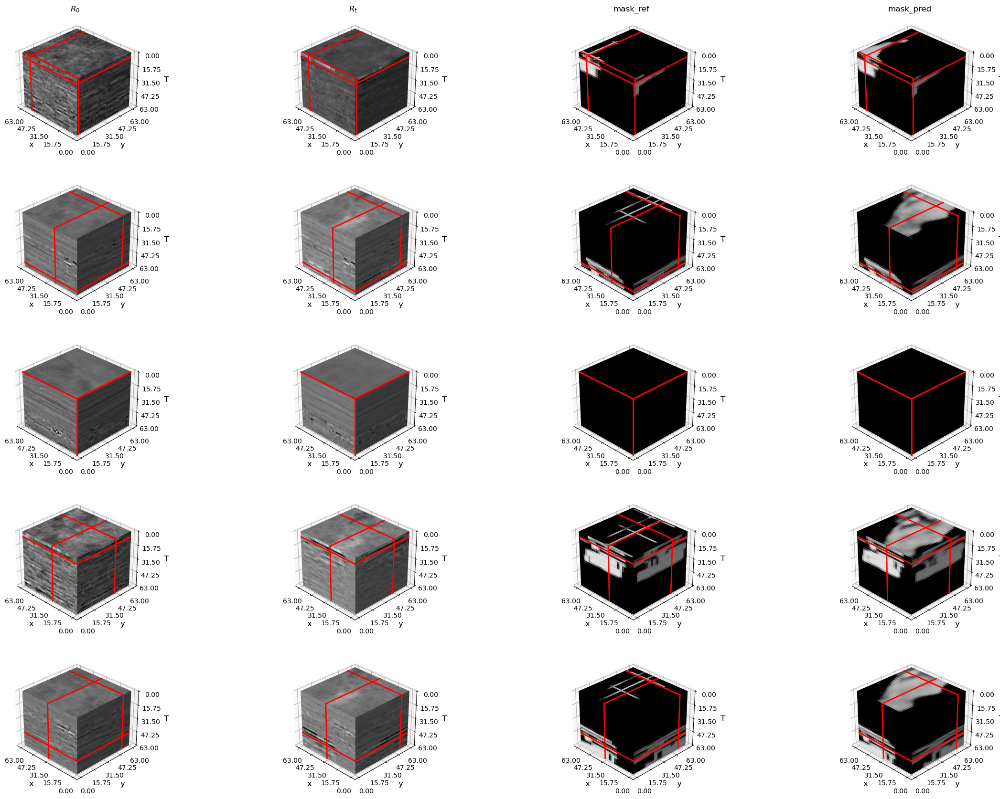

Start validating for epoch No. 60
Mean validating loss for epoch No. 60: 0.00537166381995617
Validating patch samples display at epoch No. 60


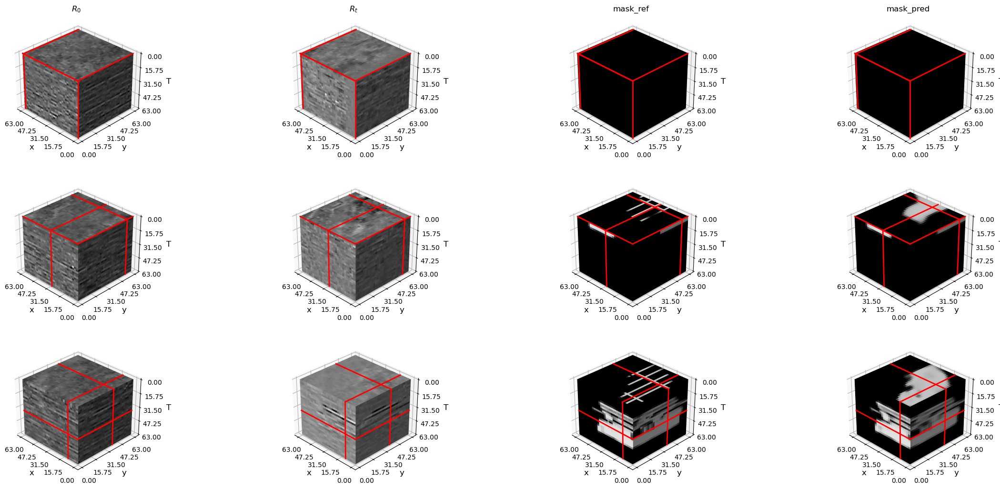

Epoch No.: 61
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 61: 0.005053688893094659
Start validating for epoch No. 61
Mean validating loss for epoch No. 61: 0.005349457877772776
Epoch No.: 62
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 62: 0.00505997832864523
Start validating for epoch No. 62
Mean validating loss for epoch No. 62: 0.005395814427174628
Epoch No.: 63
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 63: 0.005052669108845293
Start validating for epoch No. 63
Mean validating loss for epoch No. 63: 0.0053711099211465226
Epoch No.:

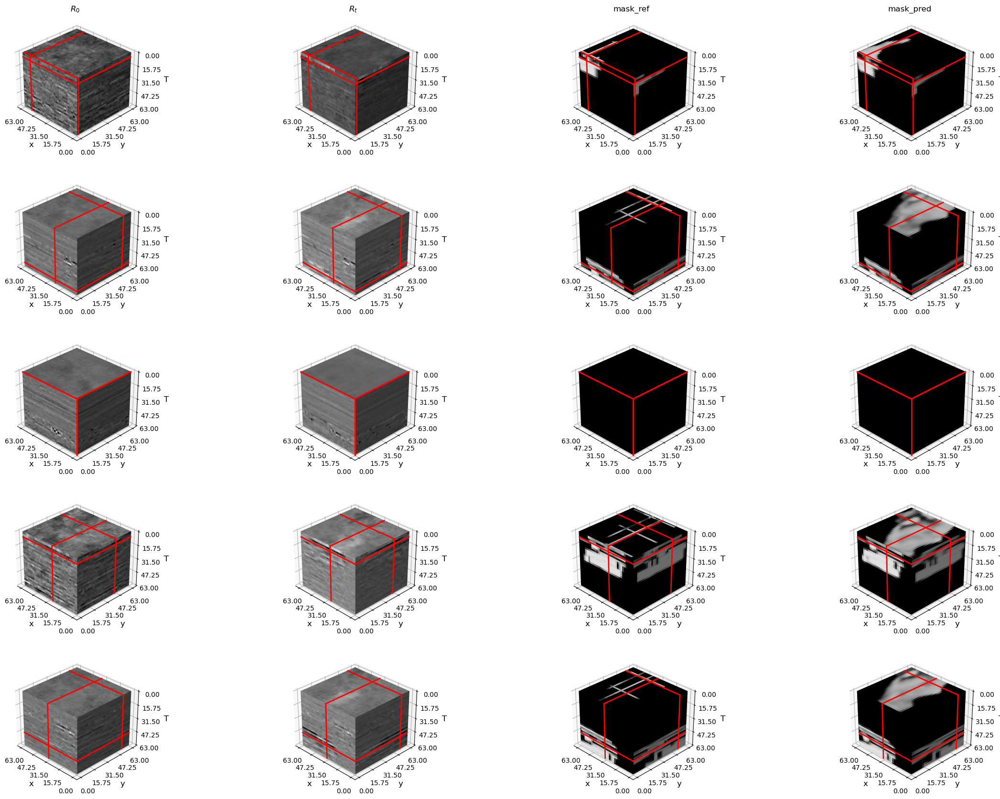

Start validating for epoch No. 80
Mean validating loss for epoch No. 80: 0.00522723754296418
Validating patch samples display at epoch No. 80


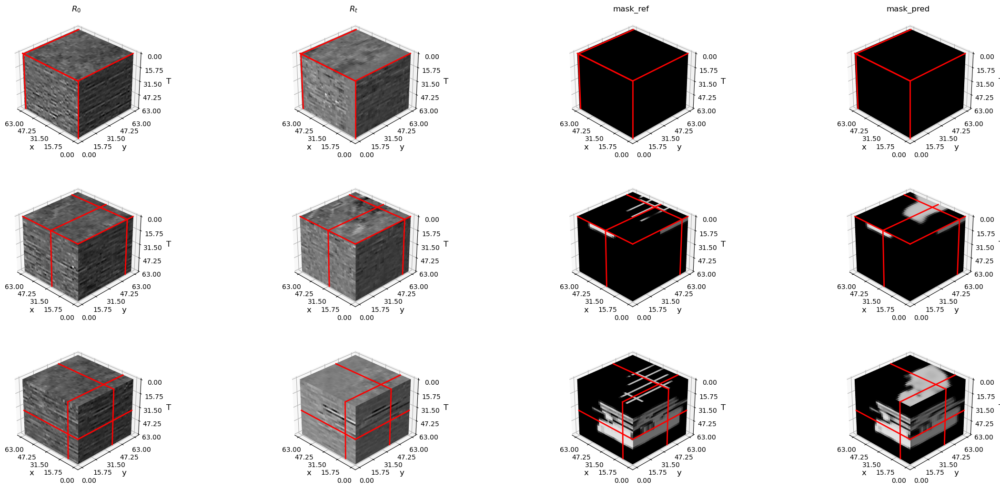

Epoch No.: 81
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 81: 0.004946277621202171
Start validating for epoch No. 81
Mean validating loss for epoch No. 81: 0.005340957638426599
Epoch No.: 82
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 82: 0.004963281978853047
Start validating for epoch No. 82
Mean validating loss for epoch No. 82: 0.0052234215862964365
Epoch No.: 83
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 83: 0.004921073969453574
Start validating for epoch No. 83
Mean validating loss for epoch No. 83: 0.005224755462470718
Epoch No.

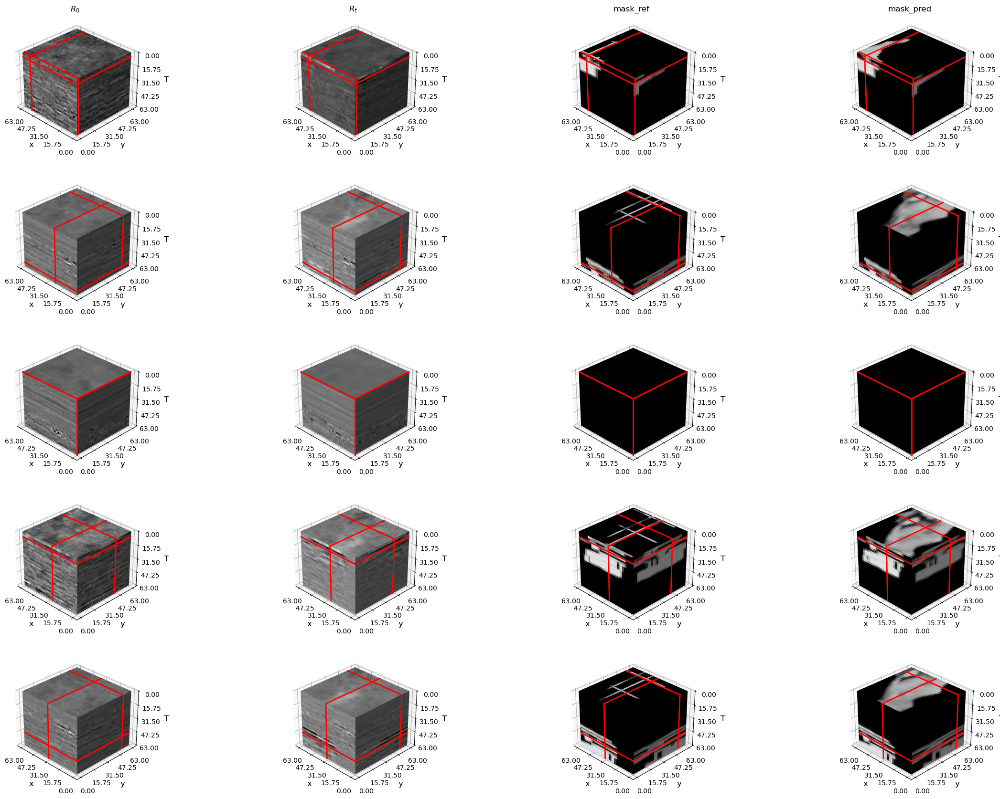

Start validating for epoch No. 100
Mean validating loss for epoch No. 100: 0.005239115101920272
Validating patch samples display at epoch No. 100


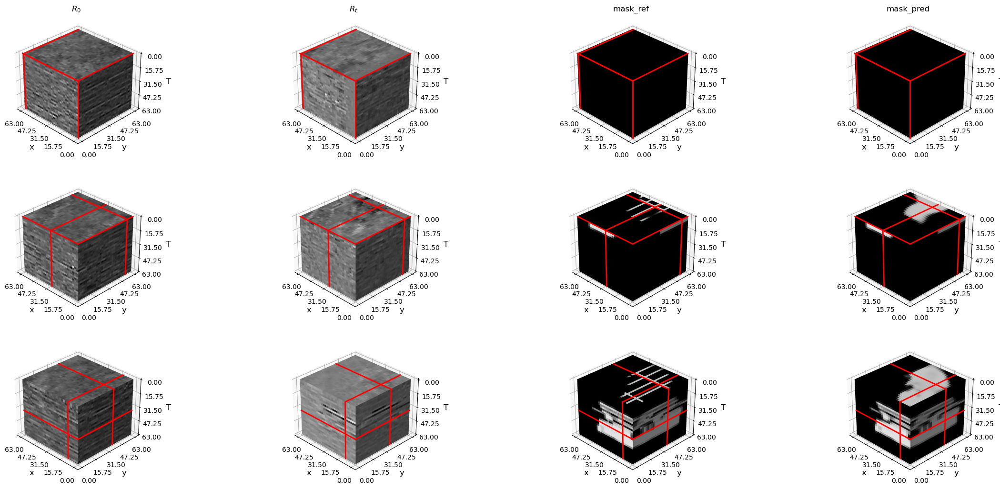

Epoch No.: 101
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 101: 0.004887600485235452
Start validating for epoch No. 101
Mean validating loss for epoch No. 101: 0.005152281008618461
Epoch No.: 102
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 102: 0.004858351913280785
Start validating for epoch No. 102
Mean validating loss for epoch No. 102: 0.005146152715579691
Epoch No.: 103
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 103: 0.004853996406309307
Start validating for epoch No. 103
Mean validating loss for epoch No. 103: 0.00514930679293518

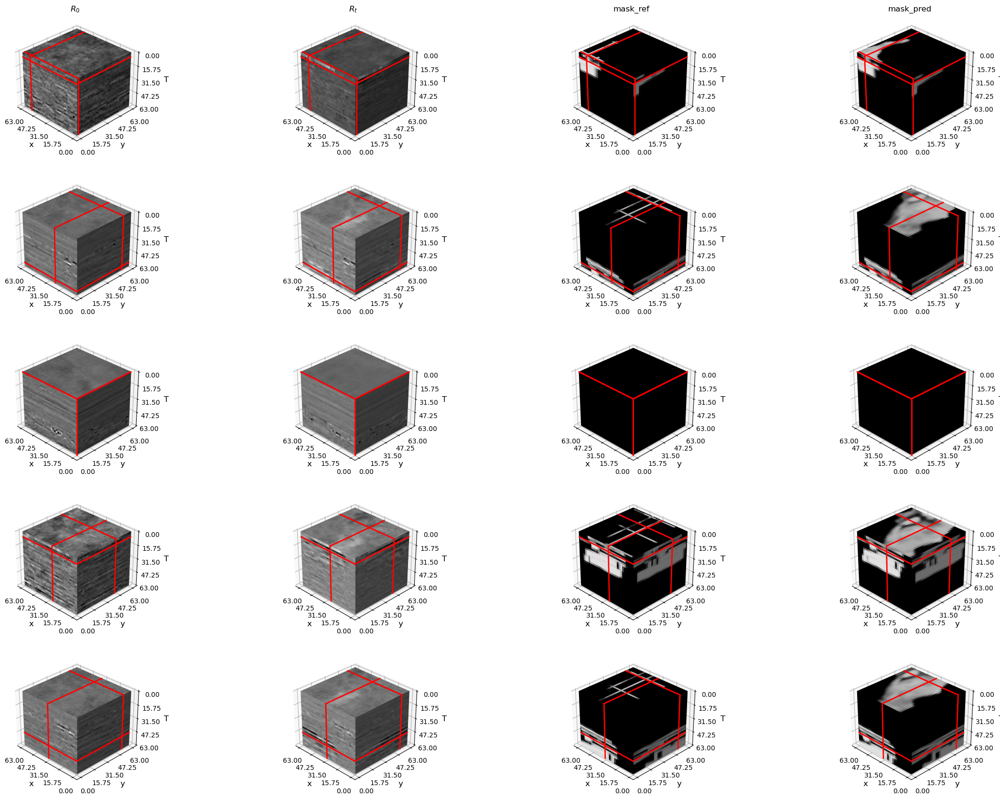

Start validating for epoch No. 120
Mean validating loss for epoch No. 120: 0.005159222420347346
Validating patch samples display at epoch No. 120


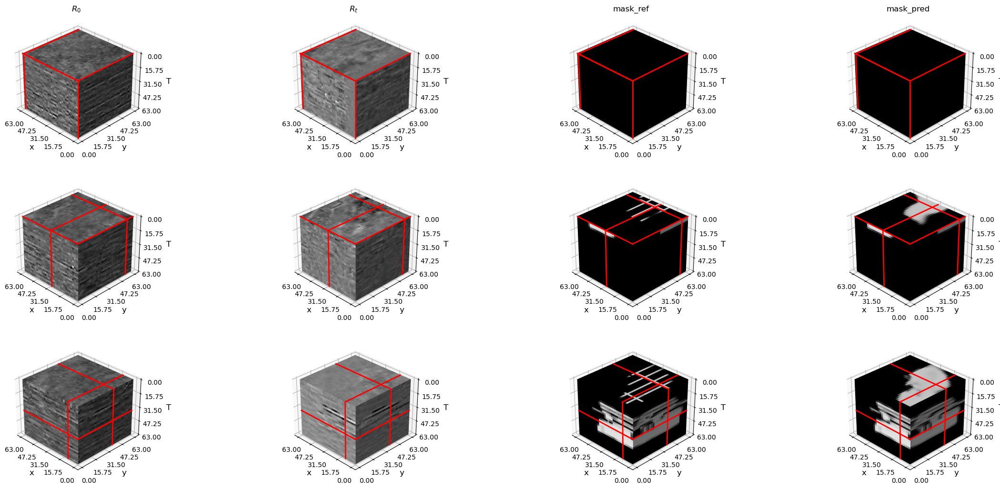

Epoch No.: 121
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 121: 0.004848883631639183
Start validating for epoch No. 121
Mean validating loss for epoch No. 121: 0.005144945679190146
Epoch No.: 122
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 122: 0.004878700324334204
Start validating for epoch No. 122
Mean validating loss for epoch No. 122: 0.005210514381443235
Epoch No.: 123
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 123: 0.0048978688521310685
Start validating for epoch No. 123
Mean validating loss for epoch No. 123: 0.0051406164156188

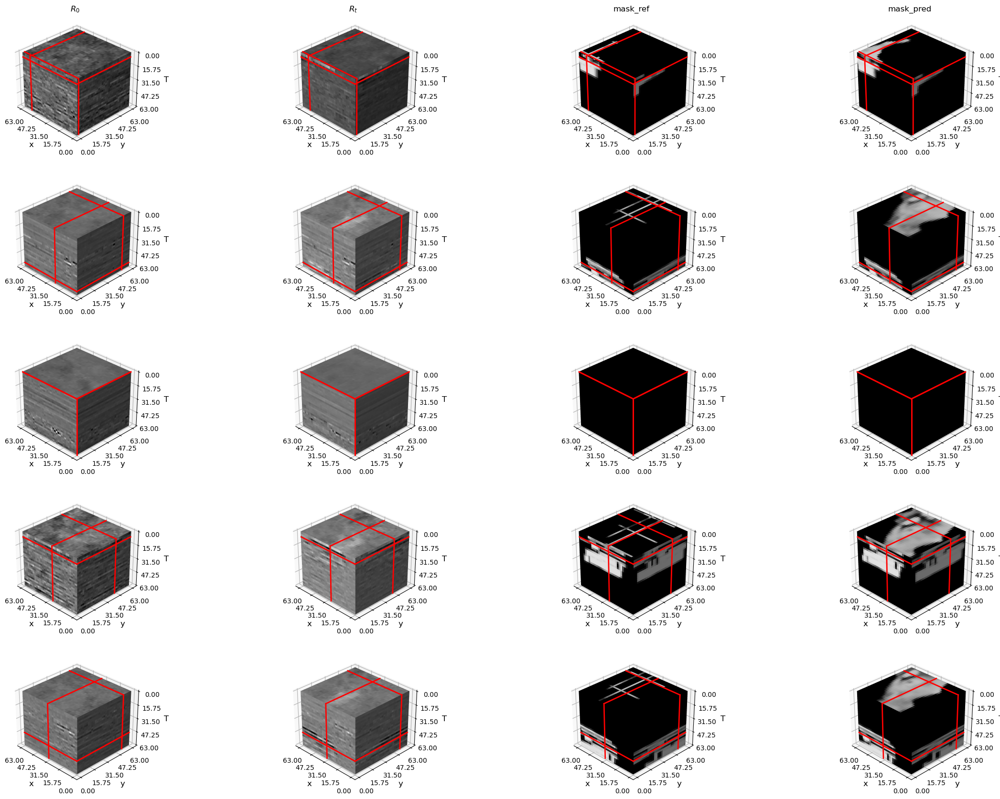

Start validating for epoch No. 140
Mean validating loss for epoch No. 140: 0.005044910400597887
Validating patch samples display at epoch No. 140


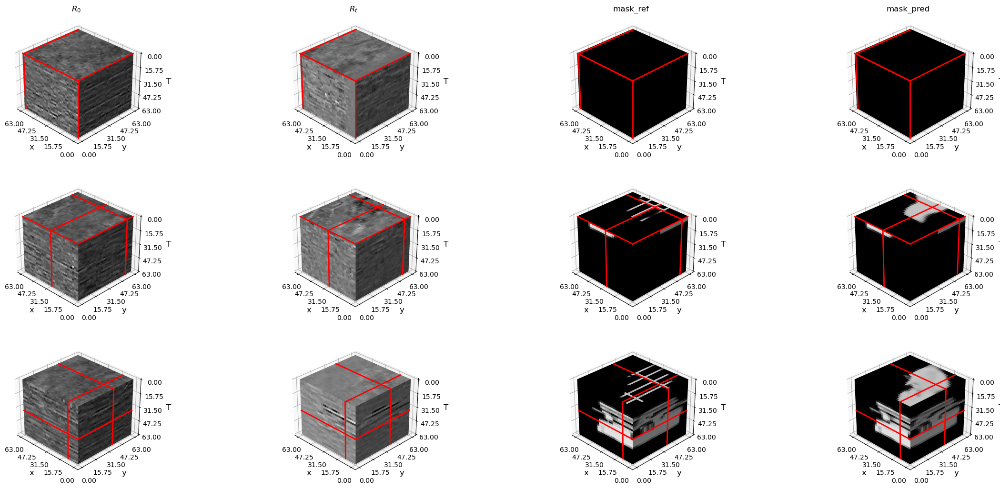

Epoch No.: 141
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 141: 0.004780427319929004
Start validating for epoch No. 141
Mean validating loss for epoch No. 141: 0.005054966075642204
Epoch No.: 142
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 142: 0.004793867468833923
Start validating for epoch No. 142
Mean validating loss for epoch No. 142: 0.005050973284100605
Epoch No.: 143
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 143: 0.004797841869294644
Start validating for epoch No. 143
Mean validating loss for epoch No. 143: 0.00508130735992877

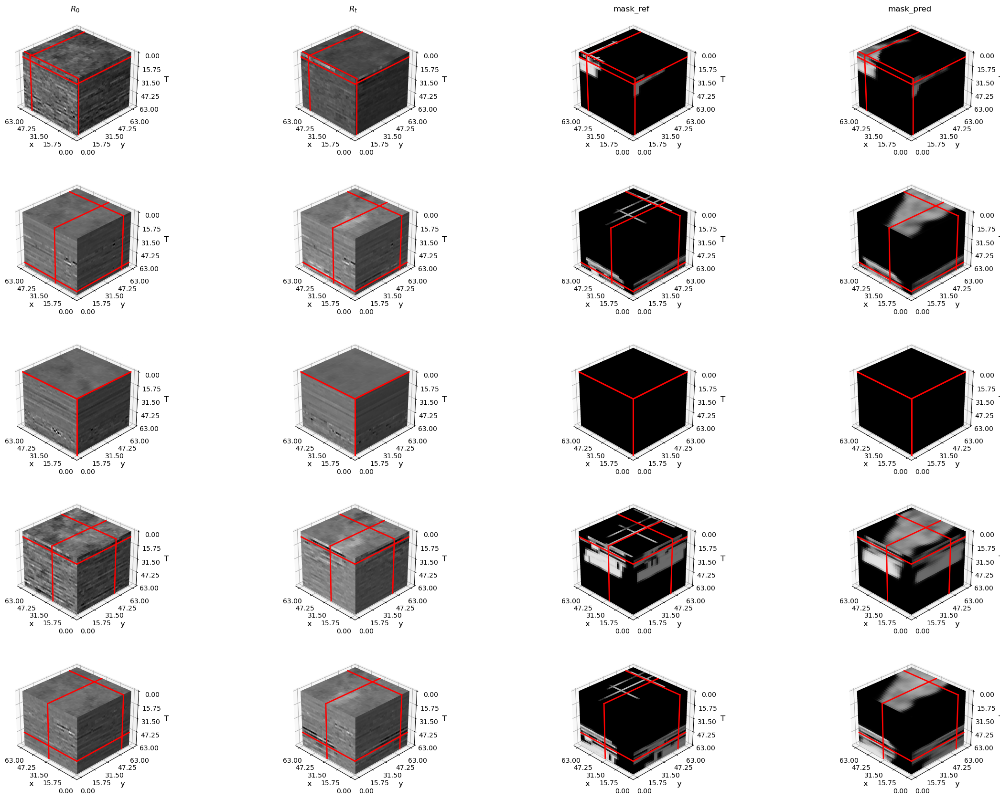

Start validating for epoch No. 160
Mean validating loss for epoch No. 160: 0.007000107561576773
Validating patch samples display at epoch No. 160


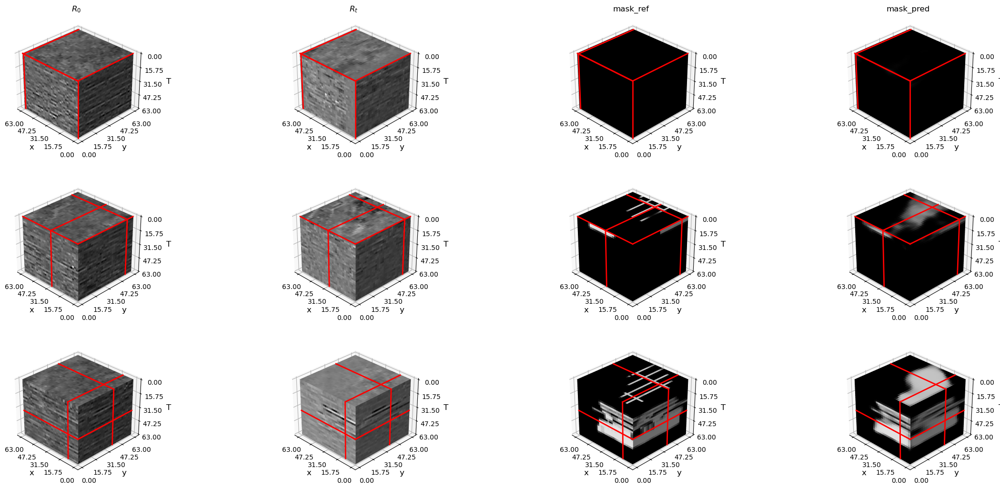

Epoch No.: 161
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 161: 0.006496608387678861
Start validating for epoch No. 161
Mean validating loss for epoch No. 161: 0.006867201840081675
Epoch No.: 162
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 162: 0.006325076897628606
Start validating for epoch No. 162
Mean validating loss for epoch No. 162: 0.006680207655087791
Epoch No.: 163
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 163: 0.006206913650967181
Start validating for epoch No. 163
Mean validating loss for epoch No. 163: 0.00654619317290119

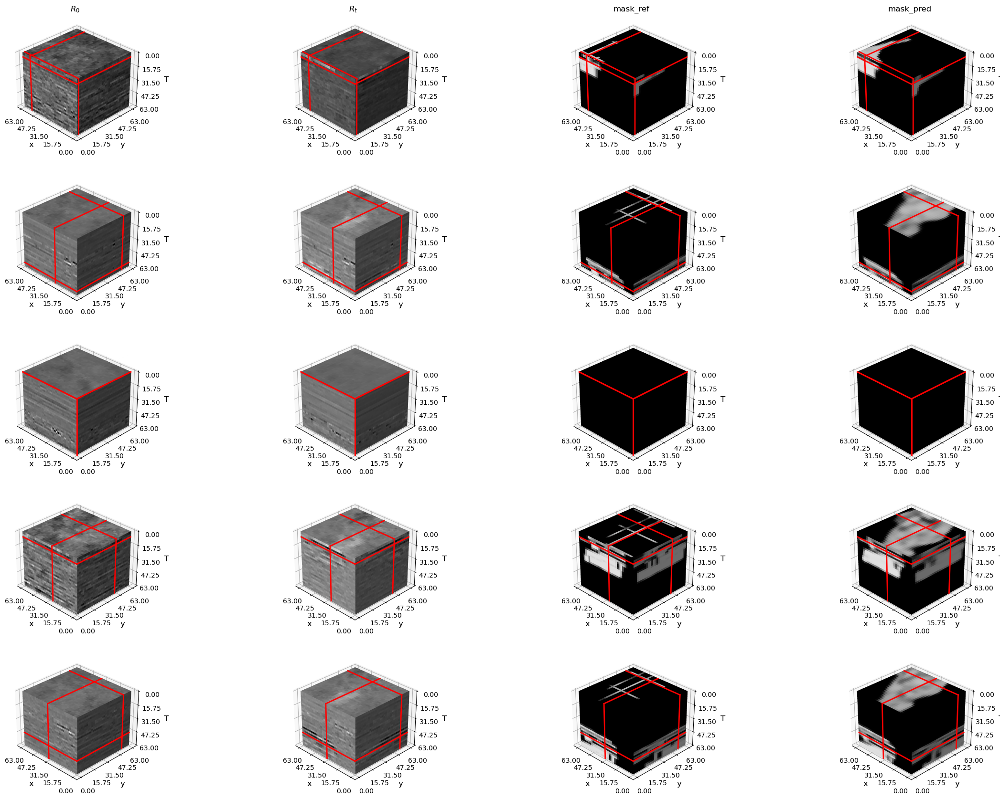

Start validating for epoch No. 180
Mean validating loss for epoch No. 180: 0.005703130885112015
Validating patch samples display at epoch No. 180


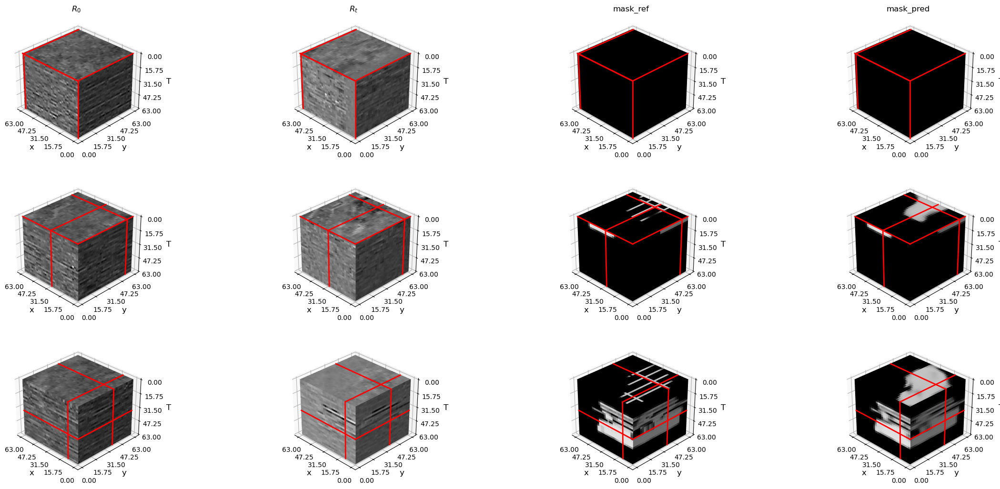

Epoch No.: 181
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 181: 0.005328839807771146
Start validating for epoch No. 181
Mean validating loss for epoch No. 181: 0.005676266028207134
Epoch No.: 182
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 182: 0.005307726329192519
Start validating for epoch No. 182
Mean validating loss for epoch No. 182: 0.005675114193846556
Epoch No.: 183
Batch No. 0--------------------
Batch No. 10--------------------
Batch No. 20--------------------
Batch No. 30--------------------
Batch No. 40--------------------
Mean training loss for epoch No. 183: 0.005283503318205476
Start validating for epoch No. 183
Mean validating loss for epoch No. 183: 0.00564221506515009

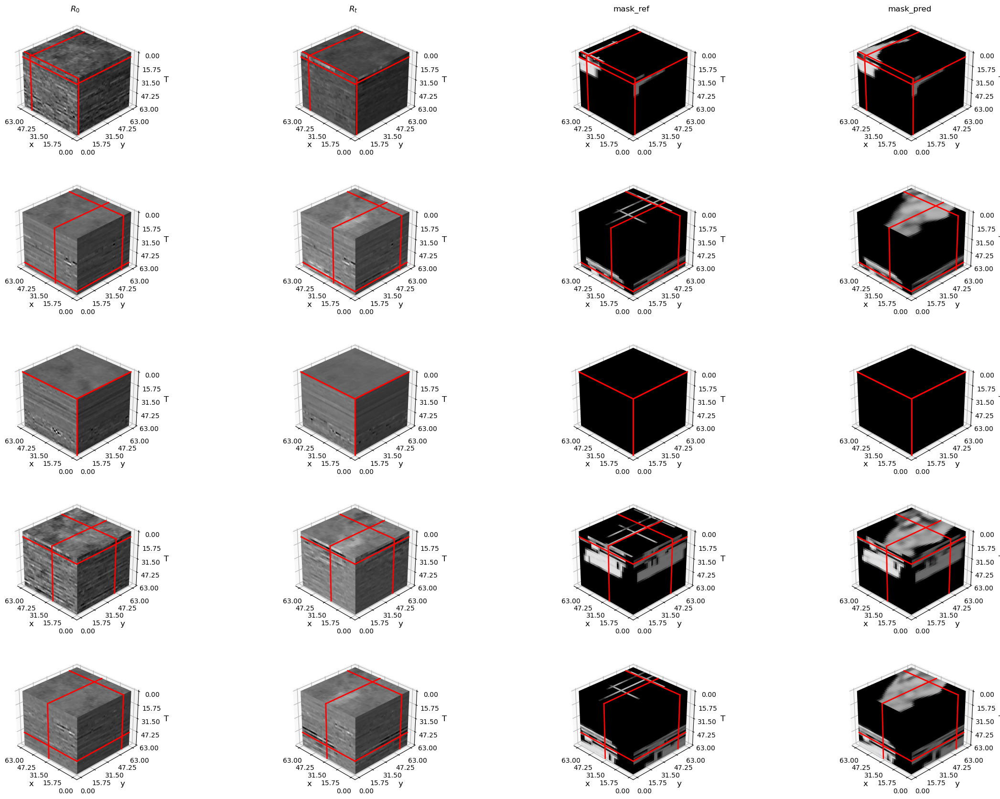

Start validating for epoch No. 199
Mean validating loss for epoch No. 199: 0.005421884151556614
Validating patch samples display at epoch No. 199


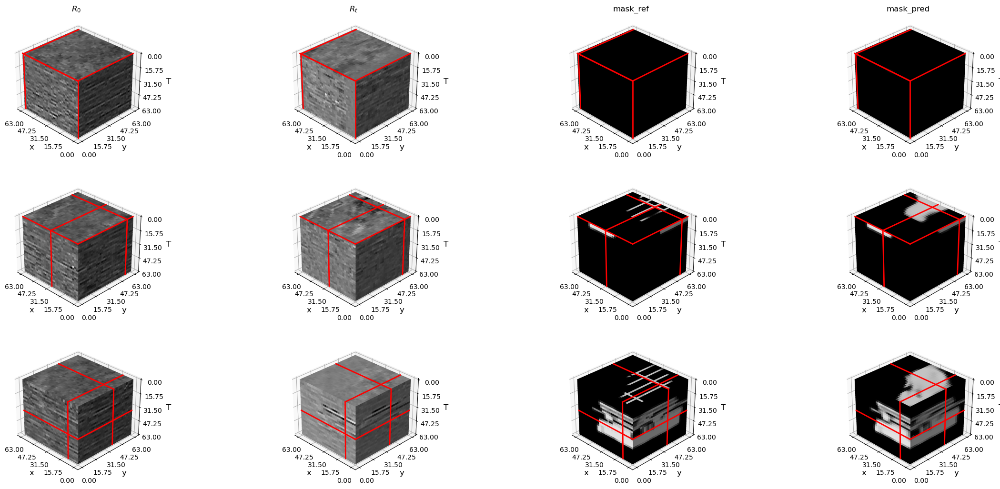

In [16]:
for run in RunBuilder.get_runs(params):
    # initialize network
    nw = 2
    network = CO2mask()
    
    # inherit from previous train network
    #network.load_state_dict(torch.load(path_bestnet,map_location=cpu_device))
    #network = network.train()

    if cuda_gpu:
        network = torch.nn.DataParallel(network, device_ids=gpus).cuda()
        nw = 0
    # train_set loader
    loader_train = DataLoader(
        train
        ,batch_size = run.batch_size
        ,shuffle = run.shuffle
        ,num_workers = nw
        ,drop_last = False)
    # valid_set loader (load the entire dataset as a single batch)
    loader_valid = DataLoader(
         valid
        ,batch_size = run.batch_size
        ,shuffle = False
        ,num_workers = nw
        ,drop_last = False)
    
    # define the initial optimizer as adadelta
    optimizer = optim.Adadelta(network.parameters())

    # initialize training and validation loss lists
    TrLoss_list = []
    VaLoss_list = []
    Bloss = float('inf') # initial smallest loss
    Bloss_epNo = 0 # intial smallest loss corresponding epoch No.
    
    # begin this training run
    M.begin_run(run, network, loader_train)
    for epoch in range(run.epoch_num):
        print(f'Epoch No.: {epoch}')
        # initialize runner
        M.begin_epoch()
        batch_id=0
        Loss = 0
        
        # adjust learning rate
        #adjust_learning_rate(optimizer, epoch, run.lr)
        
        # initialize sampled prediction arrays
        Trpred = np.zeros((ndis_tr,rs[0],rs[1],rs[2]))
        Vapred = np.zeros((ndis_va,rs[0],rs[1],rs[2]))
        
        if epoch == run.adadelta_num:
            # redefine the optimizer as adam 
            optimizer = optim.Adam(network.parameters(),run.lr)

        # loop through different batches in training dataset
        Loss = 0 # initial loss
        Np = 0 # number of patches
        C = 0 # batch No.
        for batch in loader_train:
            if C%batch_itv == 0:
                print(f'Batch No. {C}--------------------')
            C += 1
            if sliceitp:
                R0t, Mask, Weight, idx = batch
            else:
                R0t, Mask, idx = batch
            # find the indices of sampled training patches in current batch for later display
            bs = len(idx)
            Np += bs
            Idx = idx.tolist()
            cp = findtrace(train_id_list,Idx)
            # copy cpu data on GPU
            if cuda_gpu:
                R0t = R0t.cuda()
                Mask = Mask.cuda()
                if sliceitp:
                    Weight = Weight.cuda()
            # forward modeling
            pMask = network(R0t)
            
            # record the sampled training patches for later display
            for c,p in cp:
                Trpred[c] = pMask[p][0].cpu().detach().numpy()
            # validating loss
            if sliceitp:
                loss = F.binary_cross_entropy(pMask, Mask, weight=Weight)
            else:
                loss = F.binary_cross_entropy(pMask, Mask)
            #loss = BBCE(pMask, Mask)
            # backward for gradient
            optimizer.zero_grad()
            loss.backward()
            # update NN
            optimizer.step()
            # track the loss
            Loss = track_loss_out(Loss,loss,bs)

        # record the mean loss for the entire training dataset
        TrLoss_list.append(Loss/Np)
        print(f'Mean training loss for epoch No. {epoch}: {Loss/Np}')
        # display the sampled patch fitting in training dataset
        if (epoch%epoch_itv == 0) or (epoch == run.epoch_num-1):
            print(f'Training patch samples display at epoch No. {epoch}')
            pst.view3d(Trpred,rcstride=(2,2))
        
        # save the current-epoch training network
        torch.save(network.module.state_dict(),path_net)
        
        r'''
        (for cpu validating)
        # Load saved validating network on cpu
        networkvalid = CO2mask()
        networkvalid.load_state_dict(torch.load(path_net,map_location=cpu_device))
        '''
        
        networkvalid = network.eval()
        print(f'Start validating for epoch No. {epoch}')
        # loop through different batches in valid dataset
        Loss = 0 # initial loss
        Np = 0 # number of patches
        for batch in loader_valid:
            if sliceitp:
                R0t, Mask, Weight, idx = batch
            else:
                R0t, Mask, idx = batch
            # find the indices of sampled validating patches in current batch for later display
            bs = len(idx)
            Np += bs
            Idx = idx.tolist()
            cp = findtrace(valid_id_list,Idx)
            # copy cpu data on GPU
            if cuda_gpu:
                R0t = R0t.cuda()
                Mask = Mask.cuda()
                if sliceitp:
                    Weight = Weight.cuda()
            # forward modeling
            with torch.no_grad():
                pMask = networkvalid(R0t)
            # record the sampled validating patches for later display
            for c,p in cp:
                Vapred[c] = pMask[p][0].detach().cpu().numpy()   
            # valid loss
            if sliceitp:
                loss = F.binary_cross_entropy(pMask, Mask, weight=Weight)
            else:
                loss = F.binary_cross_entropy(pMask, Mask)
            #loss = BBCE(pMask, Mask)
            # track the loss
            Loss = track_loss_out(Loss,loss,bs)
        #------------------------------------------------------    
        #import os
        #os.makedirs(os.path.dirname(path_net), exist_ok=True)
        #os.makedirs(os.path.dirname(path_bestnet), exist_ok=True)
        #------------------------------------------------------ 

        # record the mean loss for the entire validating dataset
        VaLoss_list.append(Loss/Np)
        print(f'Mean validating loss for epoch No. {epoch}: {Loss/Np}')
        if epoch>0:
            if VaLoss_list[-1] < Bloss:
                # save the currently best network (providing smallest validating loss)
                torch.save(network.module.state_dict(),path_bestnet)
                Bloss = VaLoss_list[-1]
                Bloss_epNo = epoch
                
        # display the validating result
        if (epoch%epoch_itv == 0) or (epoch == run.epoch_num-1):    
            print(f'Validating patch samples display at epoch No. {epoch}')
            psv.view3d(Vapred,rcstride=(2,2))

In [17]:
et = time.time()

In [56]:
print(f'Training time: {et-st} s = {(et-st)/3600} h')

Training time: 5456.259838104248 s = 1.5156277328067356 h


(0.0, 0.1)

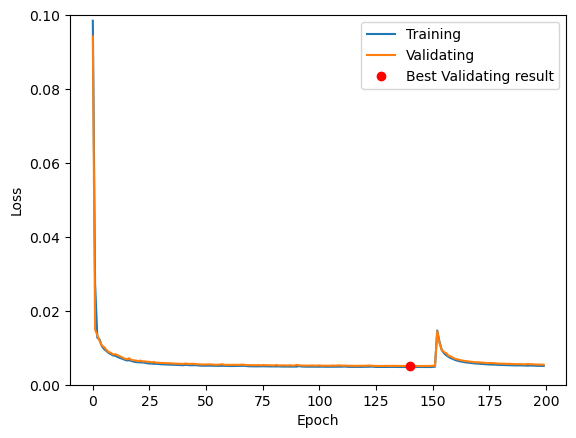

In [57]:
# plot the training and validating loss
epoch = np.arange(run.epoch_num)
fig,ax = plt.subplots(1,1)
ax.plot(epoch,TrLoss_list,label='Training')
ax.plot(epoch,VaLoss_list,label='Validating')
ax.plot(Bloss_epNo,Bloss,'ro',label='Best Validating result')
ax.legend()
ax.set_xlabel('Epoch')
ax.set_ylabel('Loss')
ax.set_ylim(0,0.1)

In [58]:
np.array(TrLoss_list,dtype=np.float32).tofile(f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_sparselabel/train_loss_sps.dat')

In [59]:
np.array(VaLoss_list,dtype=np.float32).tofile(f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_sparselabel/valid_loss_sps.dat')

## Perform testing

In [60]:
fn = '../define_path.txt'
with open(fn) as f:
    lines = f.readlines()
for idx, line in enumerate(lines):
    if idx == 1:
        dir_co2 = line.split('=')[1][:-1]
    if idx == 9:
        testpath = line.split('=')[1][:-1]

### define the network and basic information for testing

In [61]:
# testing datasets
yearlist = ['1999_b01_t01','2001_b01_t01',
            '2004_b01_t07','2006_b01_t07',
            '2008_b01_t08',
            '2010_b01_t10','2010_b01_t11','2010_b10_t10','2010_b10_t11']

In [62]:
# reference dataset grid path
xydfn = f'{dir_co2}/10p10/data/10p10nea.sgy'
# load the reference dataset head
Dr = dataload(fn=xydfn)
DD = (Dr.nx,Dr.ny,Dr.nt)

Total trace number: 150909
Sample number along each trace: 1001
Sampling interval along each trace: 0.002 s
data arrangement: 269 (number of ensembles) x 561 (trace number per ensemble) x 1001 (sample number per trace)


In [63]:
# network path
path_bestnet = f'/scratch/gilbreth/pate2126/DKP_new/NNpred3D/train_sparselabel/co2_identify_best_sps.pt'
cuda_gpu = True
gpus = [0]

In [64]:
# load the network
networktest = CO2mask()
networktest.load_state_dict(torch.load(path_bestnet,map_location=torch.device('cpu')))
networktest = networktest.eval()
if cuda_gpu:
    networktest = torch.nn.DataParallel(networktest, device_ids=gpus).cuda()
    nw = 0
networktest = networktest.eval()

/tmp/ipykernel_3453267/3059158192.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  networktest.load_state_dict(torch.load(path_bestnet,map_location=torch.device('cpu')))


In [65]:
# fixed dataset information file names
pmf = 'pm_info.json'
pdf = 'patch_info.csv'
# gpu setting
gpus = [0]
cuda_gpu = True
# batch_size of testing dataset
bs = 20
# sampling number for patch display
ndis_ts = 3

In [66]:
# reference mask dataset for training and validating
mkfn = f'../resources/label/masks.dat'
# readin CO2 mask
masks = np.fromfile(f'{mkfn}',dtype=np.float32)
masks = np.reshape(masks,DD)
# find the slice indices for display
MI = np.argmax(np.sum(masks,axis=(1,2)))
MX = np.argmax(np.sum(masks,axis=(0,2)))
MT = np.argmax(np.sum(masks,axis=(0,1)))
MIXT = (MI,MX,MT)

### start the test for all years

Testing year: 1999_b01_t01
Testing dataset size: 90
test_id_list for 1999_b01_t01: [22 45 67]


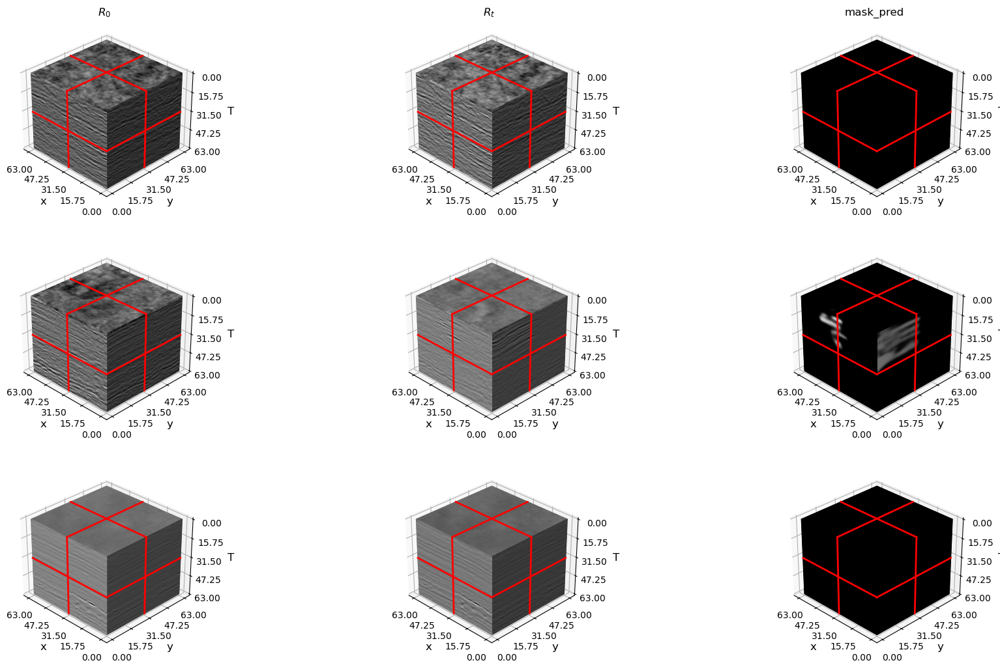

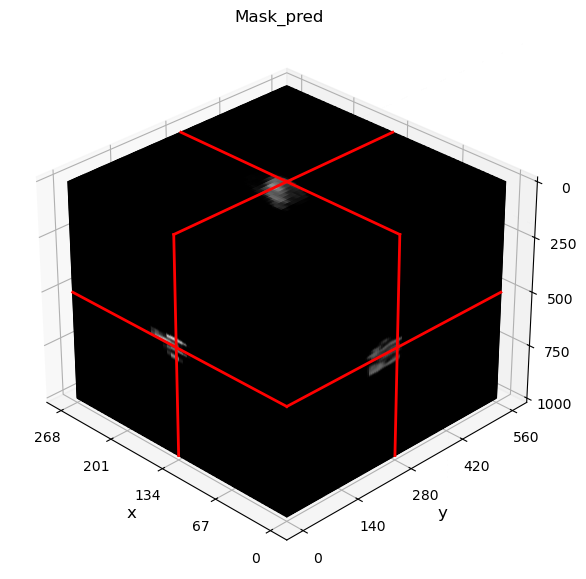

Horizontal slice Artifact above 600 ms for 1999_b01_t01:


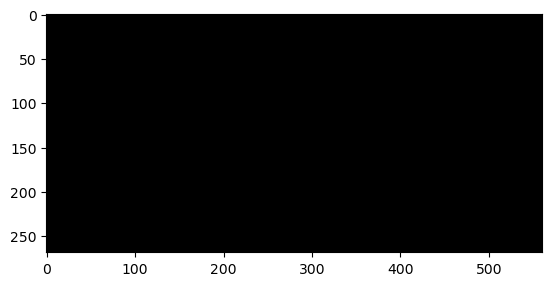

Horizontal slice Artifact below 1200 ms for 1999_b01_t01:


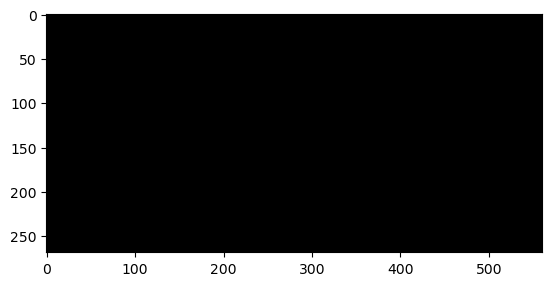

Inline assemble No. 134 for 1999_b01_t01:


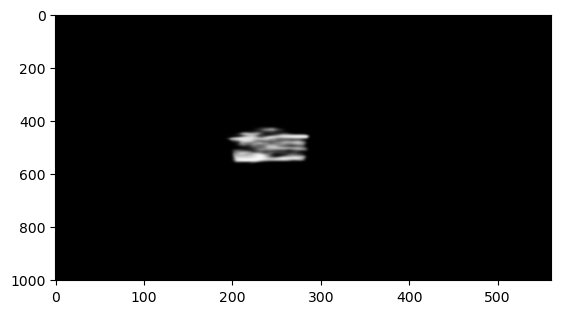

Testing year: 2001_b01_t01
Testing dataset size: 90
test_id_list for 2001_b01_t01: [22 45 67]


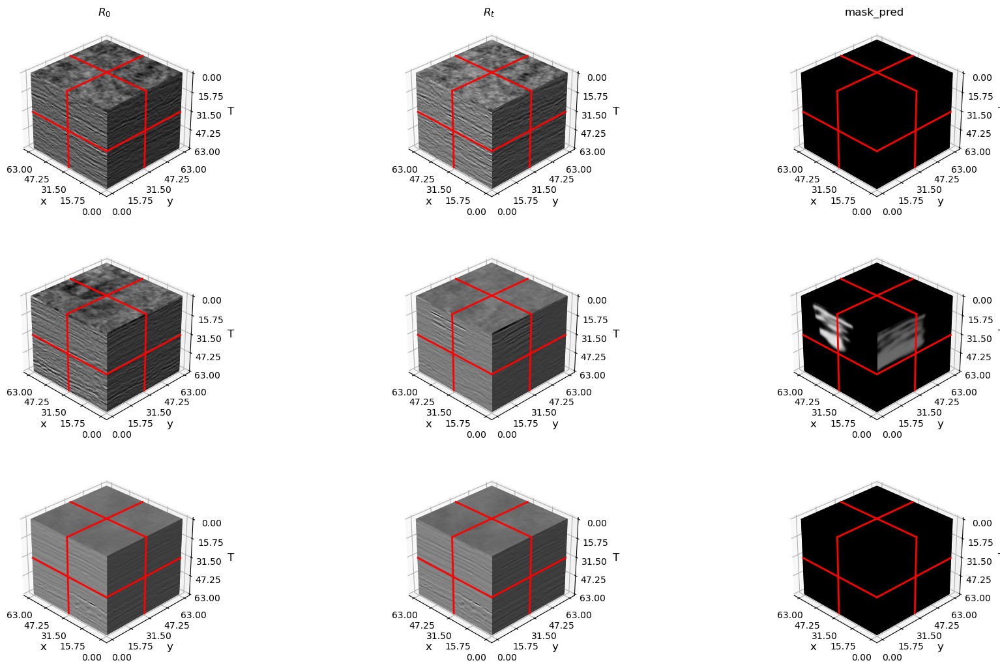

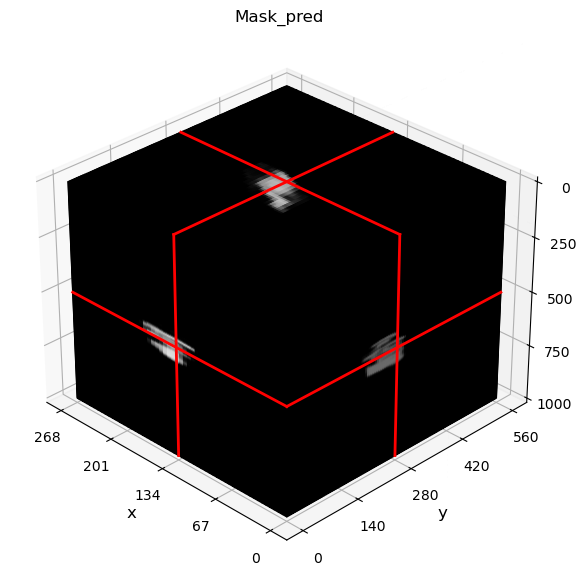

Horizontal slice Artifact above 600 ms for 2001_b01_t01:


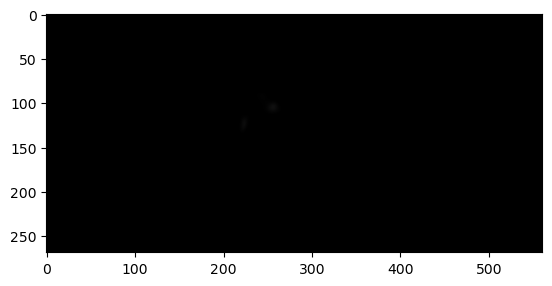

Horizontal slice Artifact below 1200 ms for 2001_b01_t01:


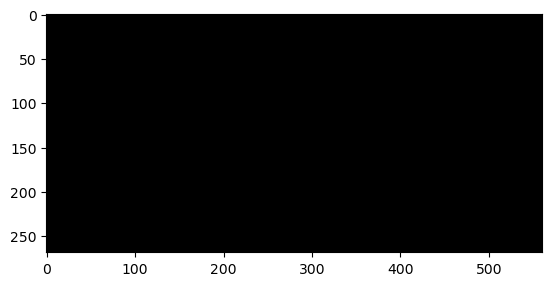

Inline assemble No. 134 for 2001_b01_t01:


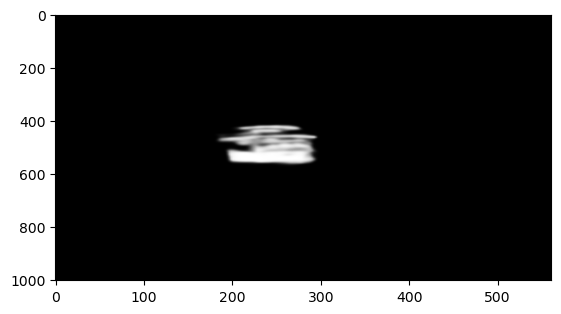

Testing year: 2004_b01_t07
Testing dataset size: 90
test_id_list for 2004_b01_t07: [22 45 67]


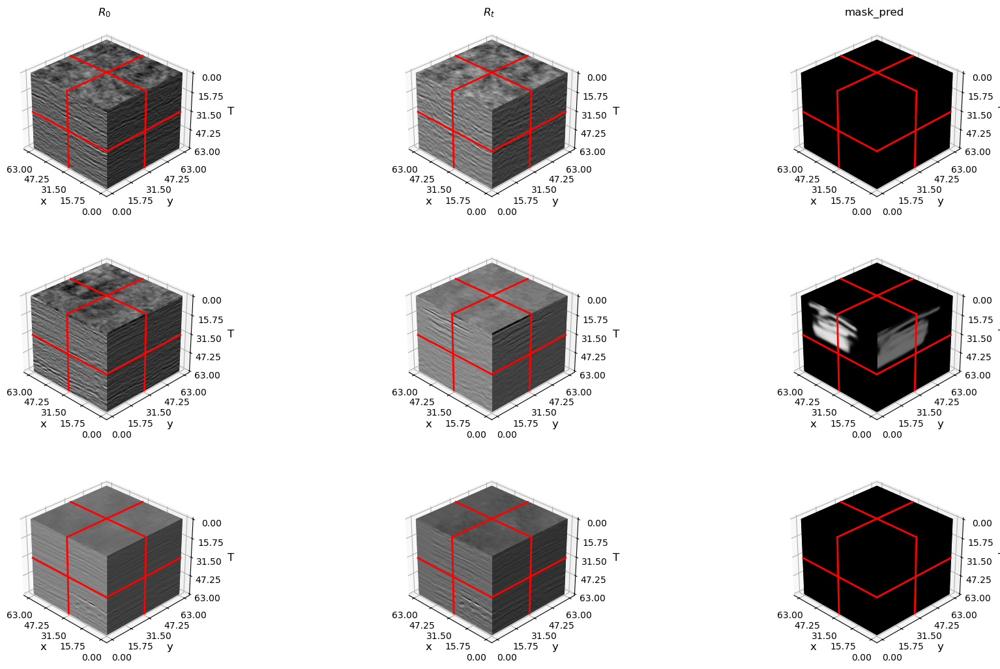

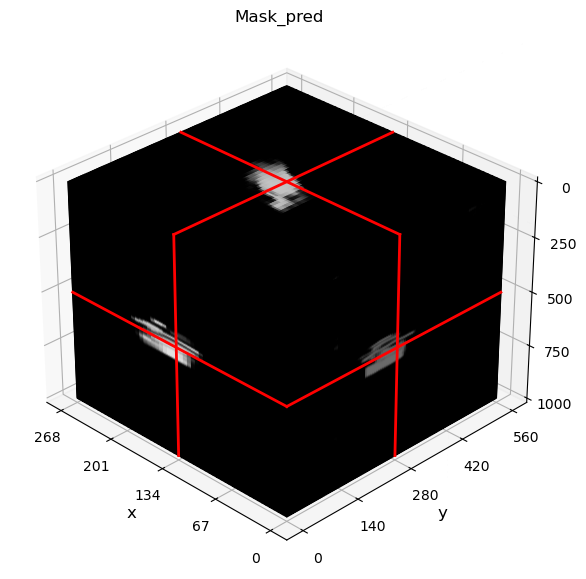

Horizontal slice Artifact above 600 ms for 2004_b01_t07:


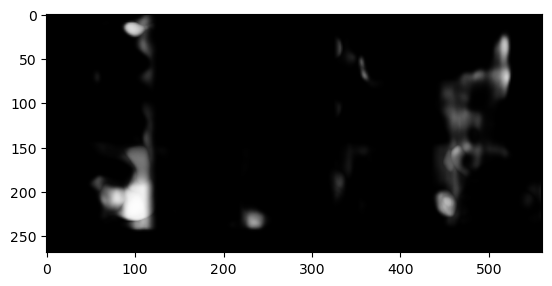

Horizontal slice Artifact below 1200 ms for 2004_b01_t07:


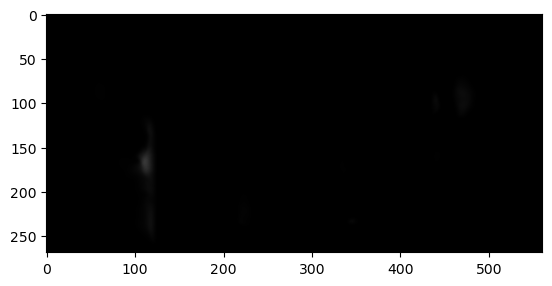

Inline assemble No. 134 for 2004_b01_t07:


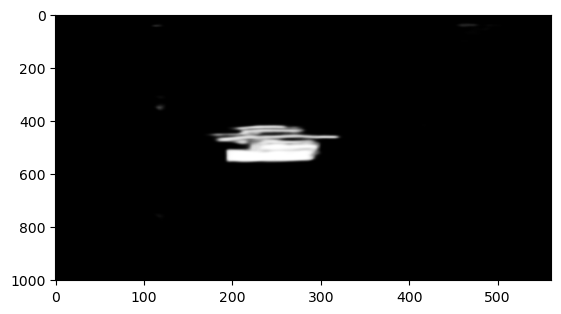

Testing year: 2006_b01_t07
Testing dataset size: 90
test_id_list for 2006_b01_t07: [22 45 67]


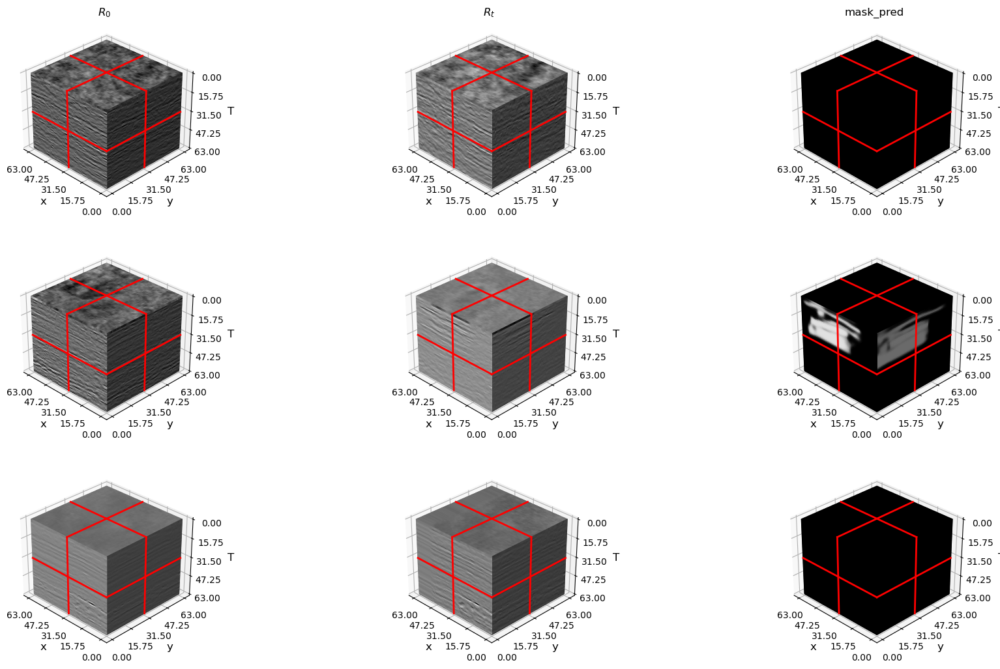

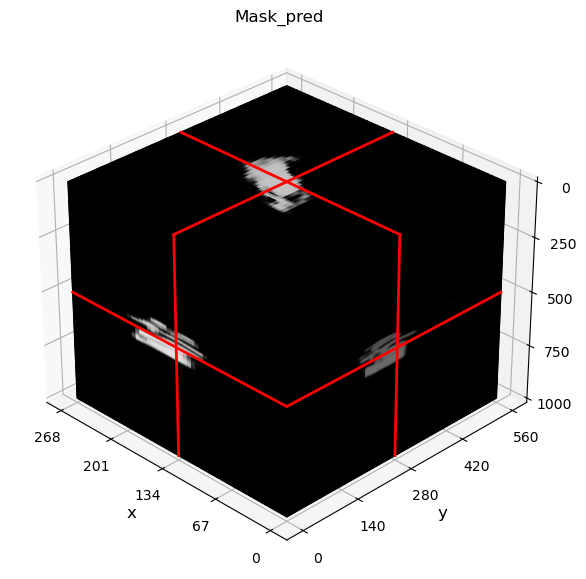

Horizontal slice Artifact above 600 ms for 2006_b01_t07:


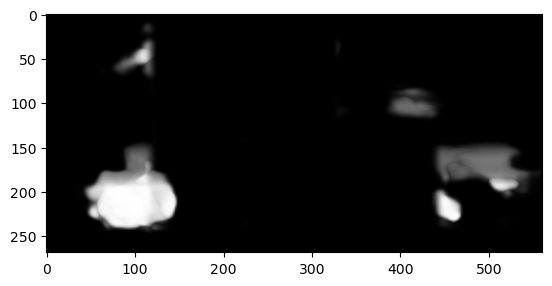

Horizontal slice Artifact below 1200 ms for 2006_b01_t07:


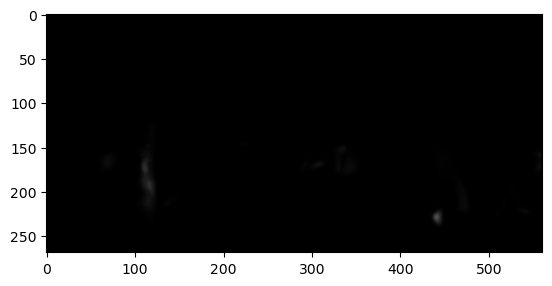

Inline assemble No. 134 for 2006_b01_t07:


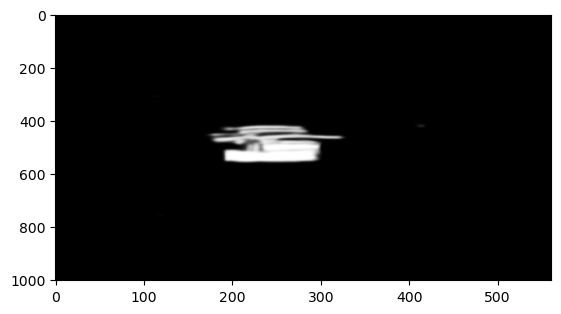

Testing year: 2008_b01_t08
Testing dataset size: 90
test_id_list for 2008_b01_t08: [22 45 67]


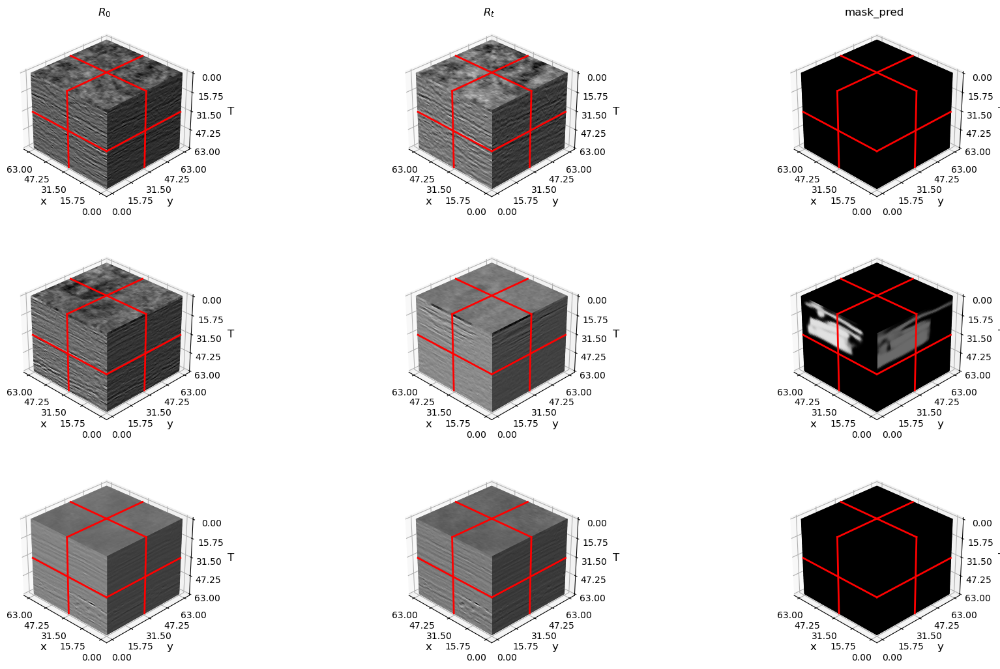

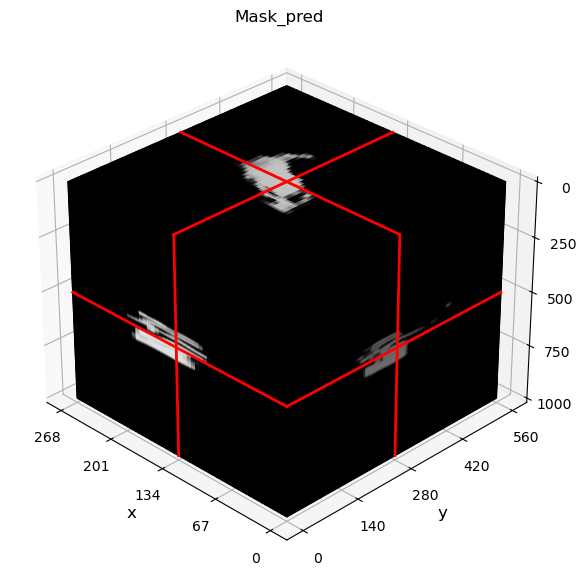

Horizontal slice Artifact above 600 ms for 2008_b01_t08:


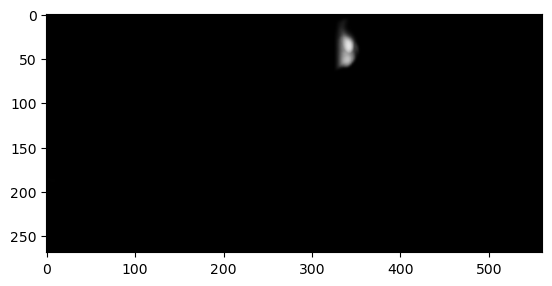

Horizontal slice Artifact below 1200 ms for 2008_b01_t08:


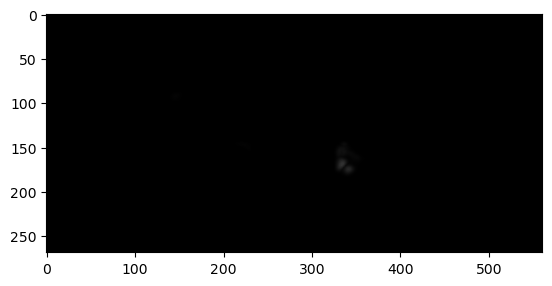

Inline assemble No. 134 for 2008_b01_t08:


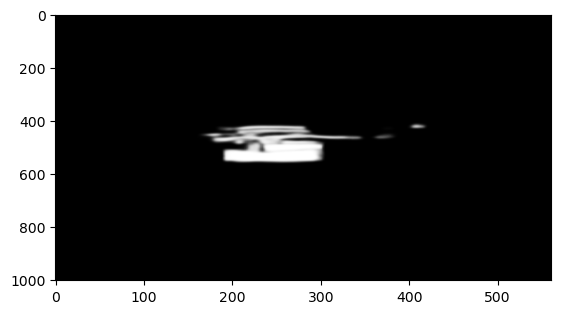

Testing year: 2010_b01_t10
Testing dataset size: 90
test_id_list for 2010_b01_t10: [22 45 67]


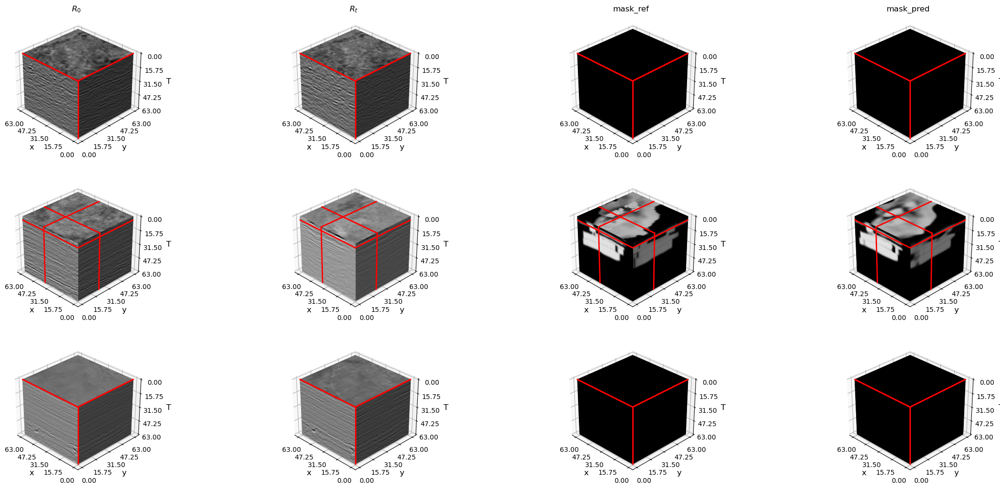

The prediction BCE loss for 2010_b01_t10 is 0.006726894062012434!


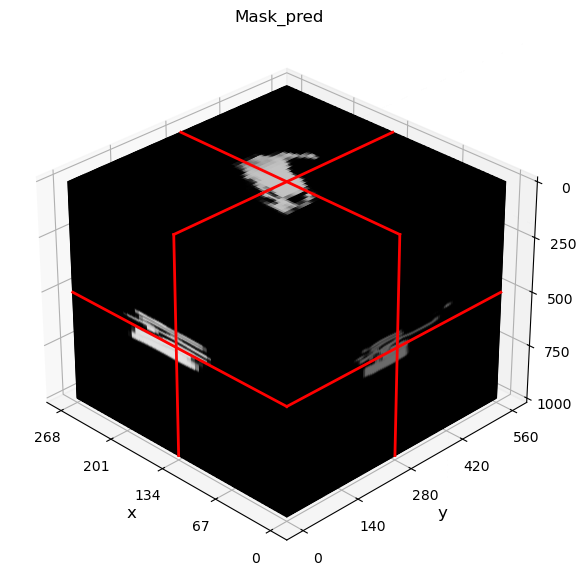

Horizontal slice Artifact above 600 ms for 2010_b01_t10:


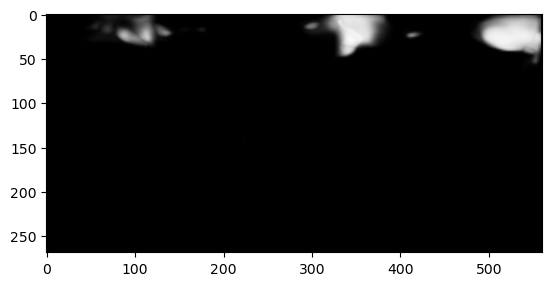

Horizontal slice Artifact below 1200 ms for 2010_b01_t10:


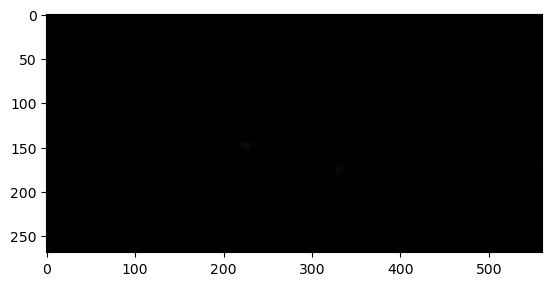

Inline assemble No. 134 for 2010_b01_t10:


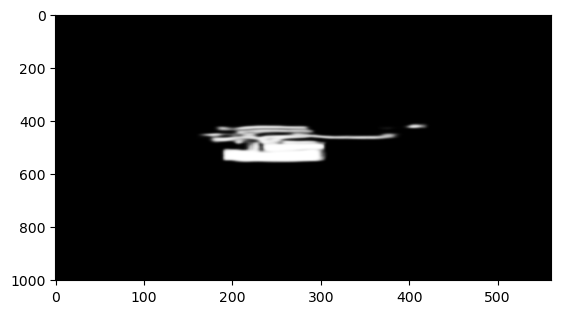

Reference Inline assemble No. 134 for 2010_b01_t10:


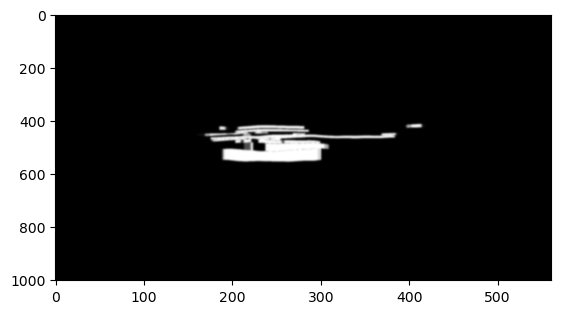

Testing year: 2010_b01_t11
Testing dataset size: 90
test_id_list for 2010_b01_t11: [22 45 67]


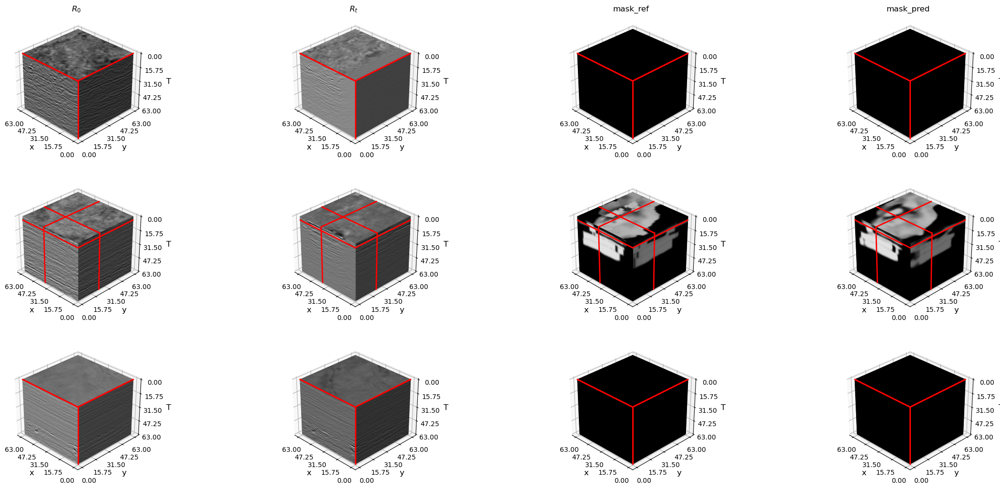

The prediction BCE loss for 2010_b01_t11 is 0.006074871867895126!


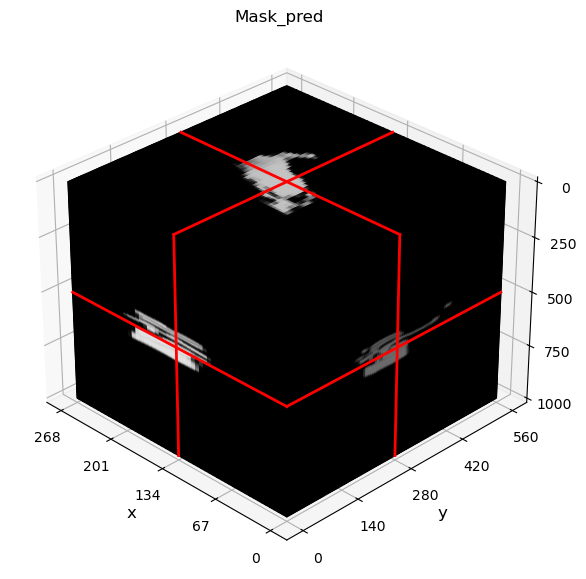

Horizontal slice Artifact above 600 ms for 2010_b01_t11:


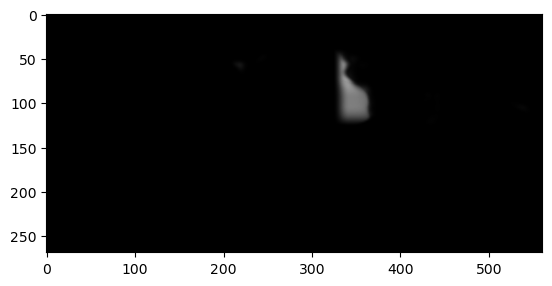

Horizontal slice Artifact below 1200 ms for 2010_b01_t11:


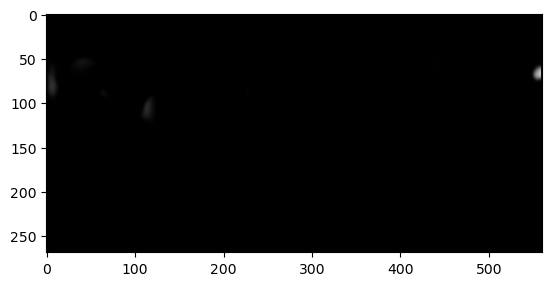

Inline assemble No. 134 for 2010_b01_t11:


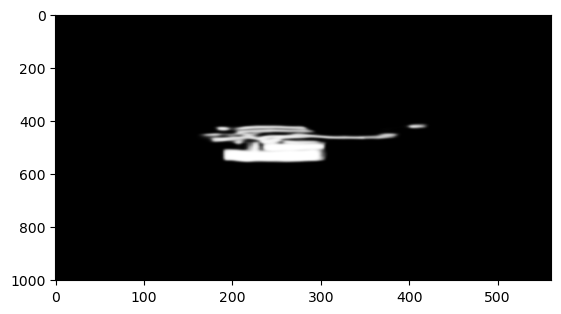

Reference Inline assemble No. 134 for 2010_b01_t11:


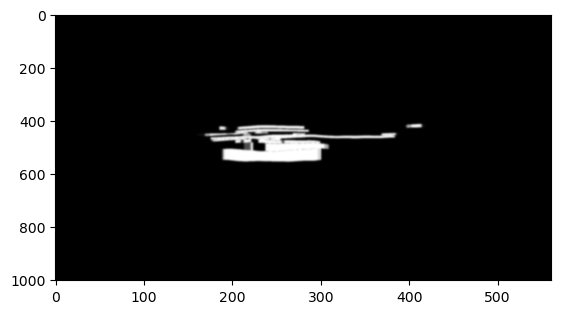

Testing year: 2010_b10_t10
Testing dataset size: 90
test_id_list for 2010_b10_t10: [22 45 67]


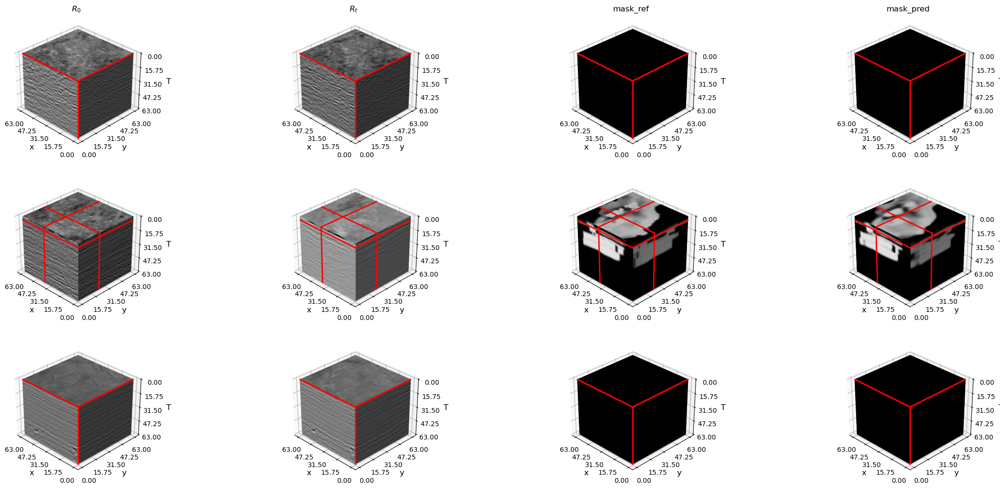

The prediction BCE loss for 2010_b10_t10 is 0.005887665320187807!


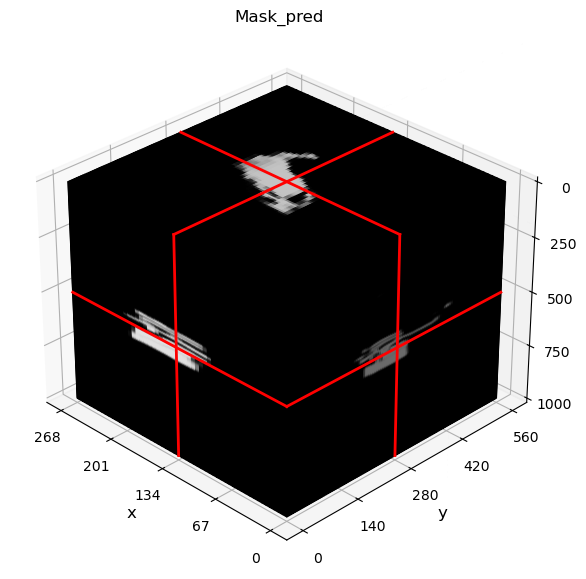

Horizontal slice Artifact above 600 ms for 2010_b10_t10:


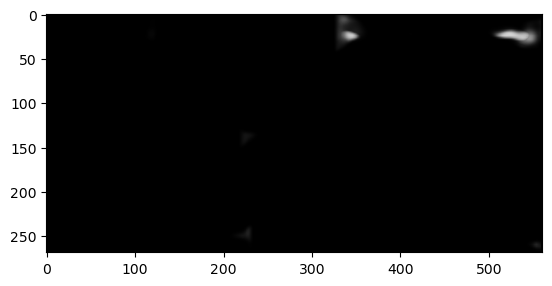

Horizontal slice Artifact below 1200 ms for 2010_b10_t10:


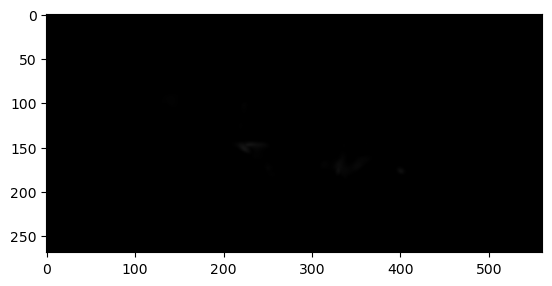

Inline assemble No. 134 for 2010_b10_t10:


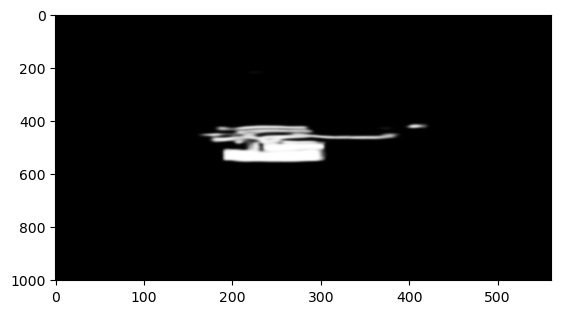

Reference Inline assemble No. 134 for 2010_b10_t10:


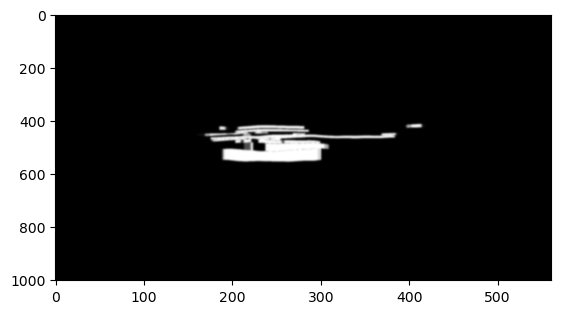

Testing year: 2010_b10_t11
Testing dataset size: 90
test_id_list for 2010_b10_t11: [22 45 67]


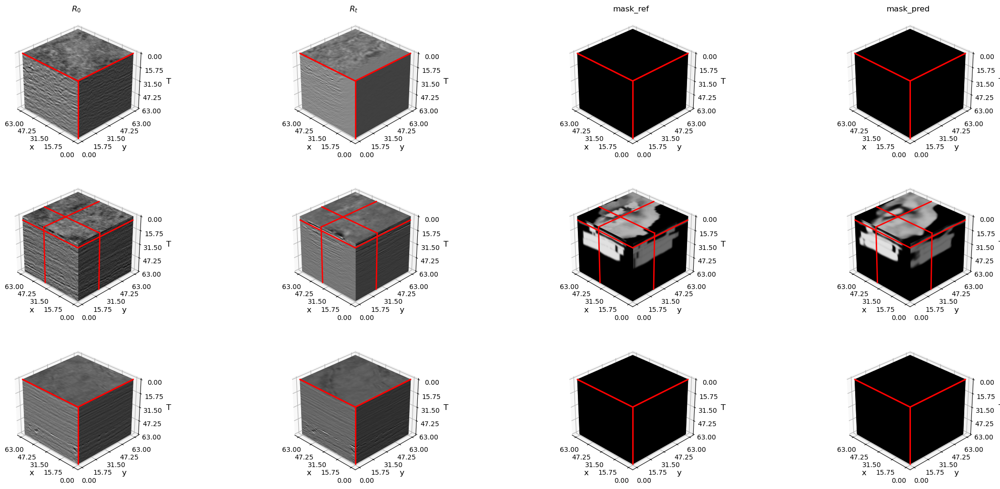

The prediction BCE loss for 2010_b10_t11 is 0.0068832095712423325!


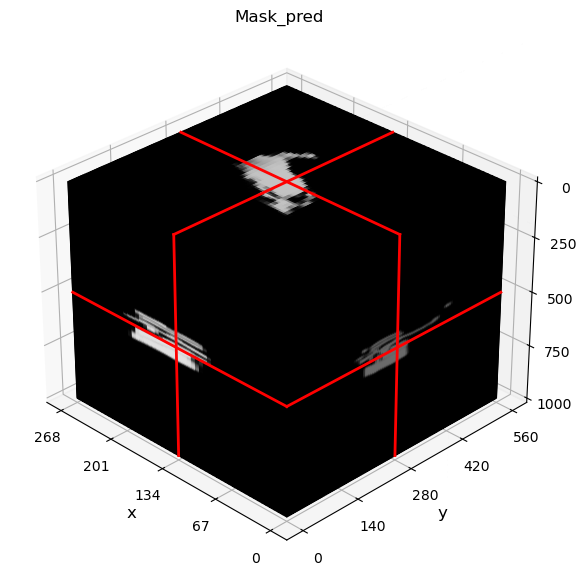

Horizontal slice Artifact above 600 ms for 2010_b10_t11:


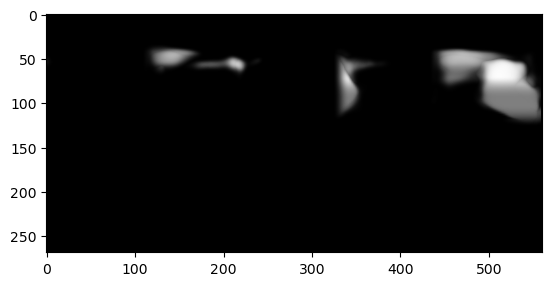

Horizontal slice Artifact below 1200 ms for 2010_b10_t11:


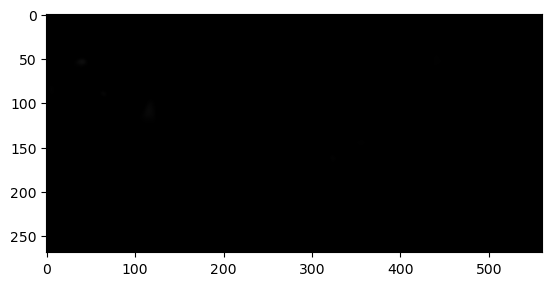

Inline assemble No. 134 for 2010_b10_t11:


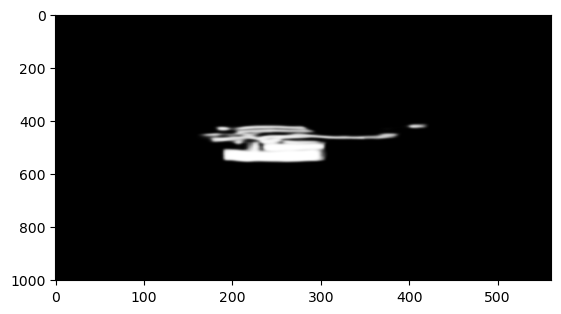

Reference Inline assemble No. 134 for 2010_b10_t11:


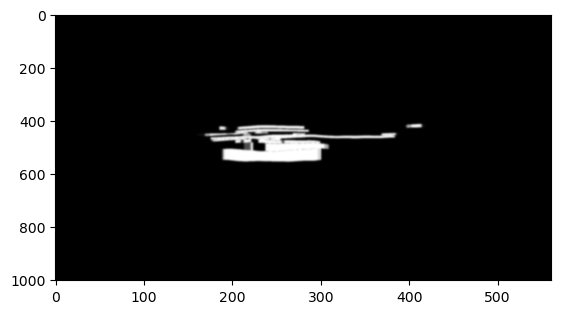

In [67]:
for year in yearlist:
    print(f'Testing year: {year}')
    # load test dataset
    root_test = f'{testpath}/{year}/test'
    if year[:4] == '2010':
        maskyear = True
    else:
        maskyear = False
    test = dataset_patch(root_test,pmf,pdf,mask=maskyear)
    Ntest = len(test)
    print(f'Testing dataset size: {Ntest}')
    # define the sampled patches in test dataset for display

    #test_id_list = np.random.choice(len(test),size=ndis_ts,replace=False)
    test_id_list = np.linspace(0,Ntest,ndis_ts+2,dtype=np.int16)[1:-1]
    pss = patch_show(test,test_id_list)
    print(f'test_id_list for {year}: {test_id_list}')
    
    # display the test patches
    #pss.view3d(rcstride=(1,1))
    
    # patch size
    rs = test.nsz
    # define the resize class for combining the predicted testing patches
    trs3 = resize3d(Ntest,D=test.osz[0],H=test.osz[1],W=test.osz[2])
    # loop through different batches in testing dataset
    loader_test = DataLoader(
         test
        ,batch_size = bs
        ,drop_last = False)
    # allocate memory for testing batches
    Tepred = np.zeros((ndis_ts,rs[0],rs[1],rs[2]))
    teMasks = torch.zeros((Ntest,1,rs[0],rs[1],rs[2]),dtype=torch.float32)
    Np = 0 # current accumulative number of patches
    for batch in loader_test:
        if test.mask:
            R0t, _, idx = batch
        else:
            R0t, idx = batch
        # copy cpu data on GPU
        if cuda_gpu:
            R0t = R0t.cuda()
        # forward modeling
        bs = len(idx)
        Np += bs
        # find the indices of sampled testing patches in current batch for later display
        Idx = idx.tolist()
        cp = findtrace(test_id_list,Idx)
        # forward modeling
        with torch.no_grad():
            pMask = networktest(R0t)
        # record the sampled testing patches for later display
        for c,p in cp:
            Tepred[c] = pMask[p][0].cpu().detach().numpy()
        # save pMask for final combination
        teMasks[Np-bs:Np] = pMask.detach()

    # display the sampled patch fitting in validating dataset
    pss.view3d(Tepred,rcstride=(1,1))
    # combine pMask
    pMask_cb = patch_combine_3D(teMasks,test,trs3)
    # save pMask
    pMask_cb.tofile(f'{root_test}/tsMask_sps.dat')
    teMasks.numpy().tofile(f'{root_test}/ts_patchMask_sps.dat')
    if year[:4] == '2010':
        # calculate BCE loss for 2010 data
        pMask_cb[pMask_cb>1.0] = 1.0
        tmp = F.binary_cross_entropy(torch.tensor(pMask_cb),torch.tensor(masks))
        np.array(tmp).tofile(f'{root_test}/BCE_loss_sps.dat')
        print(f'The prediction BCE loss for {year} is {tmp}!')
    # display the combined prediction in 3D
    fig = plt.figure(figsize=(9,7))
    ax = fig.add_subplot(1,1,1,projection='3d')
    _ = show3D(pMask_cb,ax=ax,xyzi=(test.DD[0]//2,test.DD[1]//2,test.DD[2]//2),
               clim=[0,1],rcstride=(5,5),tl=f'Mask_pred')
    plt.show()
    # display the combined prediction in slices
    print(f'Horizontal slice Artifact above 600 ms for {year}:')
    plt.imshow(np.max(pMask_cb[:,:,:300],axis=2),vmin=0,vmax=1,aspect=1,cmap='gray')
    plt.show()
    print(f'Horizontal slice Artifact below 1200 ms for {year}:')
    plt.imshow(np.max(pMask_cb[:,:,600:],axis=2),vmin=0,vmax=1,aspect=1,cmap='gray')
    plt.show()
    print(f'Inline assemble No. 134 for {year}:')
    plt.imshow(pMask_cb[134,:,:].T,vmin=0,vmax=1,aspect=0.3,cmap='gray')
    plt.show()
    if year[:4] == '2010':
        print(f'Reference Inline assemble No. 134 for {year}:')
        plt.imshow(masks[134,:,:].T,vmin=0,vmax=1,aspect=0.3,cmap='gray')
        plt.show()